# 데이터사이언스융합학과 2024710658 박창준

#### 계정 마운트

In [1]:
# 계정을 구글 드라이브에 마운트
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
# 필요한 패키지 / 라이브러리 불러오기
import numpy as np
import cv2
import random
from PIL import Image
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

In [3]:
# 이미지 파일 경로
image_path = '/content/drive/MyDrive/paired_images/annapurna_left_01.png'

# 이미지 불러오기
image_pil = Image.open(image_path)
image = np.array(image_pil)

### [문제 1. Feature Descriptor and Feature Matching (30 pts)]

#### 1-1. 임의의 이미지에서 ①그리드 형식으로 작은 이미지(image patch)를 생성하는 함수를 구현하고 그 결과를 확인해보세요.

In [4]:
def make_patches(image, width = 50, height = 50, stride = 30):
    patches = []
    keypoints = []
    H, W, _ = image.shape

    # 이미지를 스트라이드에 따라 패치로 자르는 과정
    for h_i in range(0, H - height + 1, stride):
        for w_i in range(0, W - width + 1, stride):

            # 패치를 슬라이싱
            patch = image[h_i:h_i + height, w_i:w_i + width]

            # 패치의 중심점 계산
            center_x = w_i + width // 2
            center_y = h_i + height // 2

            # KeyPoint 객체 생성
            keypoint = cv2.KeyPoint(x=center_x, y=center_y, size=(width + height) / 2.0)

            # 리스트에 추가
            patches.append(patch)
            keypoints.append(keypoint)

    return patches, keypoints

- 코드설명 :
1. make_patches 함수는 이미지와 패치의 너비, 높이, 스트라이드를 입력으로 받습니다.
2. patches와 keypoints라는 빈 리스트를 생성합니다. patches는 이미지에서 잘린 패치를 저장하고, keypoints는 각 패치의 중심점을 저장합니다.
3. 이미지의 높이와 너비를 구해 H, W에 저장합니다.
4. 이미지를 스트라이드에 따라 패치로 자르는 두 개의 중첩된 반복문을 사용합니다. stride는 이미지 패치로 자를 때 이동하는 간격을 나타냅니다.
5. 슬라이싱을 통해 패치를 patch 변수에 할당합니다.
6. 패치의 중심점을 계산합니다. 중심점의 x좌표는 패치가 시작되는 x좌표에 패치의 너비의 절반을 더한 값이고, y좌표는 패치가 시작되는 y좌표에 패치의 높이의 절반을 더한 값입니다.
7. cv2.KeyPoint를 통해 현재 패치의 keypoint를 추출하고 keypoint 객체에 저장합니다.
8. 잘린 패치와 해당 중심점을 patches와 keypoints 리스트에 추가합니다.
9. 모든 패치를 처리한 후, patches와 keypoints 리스트를 반환합니다.

In [5]:
# 함수 호출
patches, keypoints = make_patches(image, 100, 100, 100)

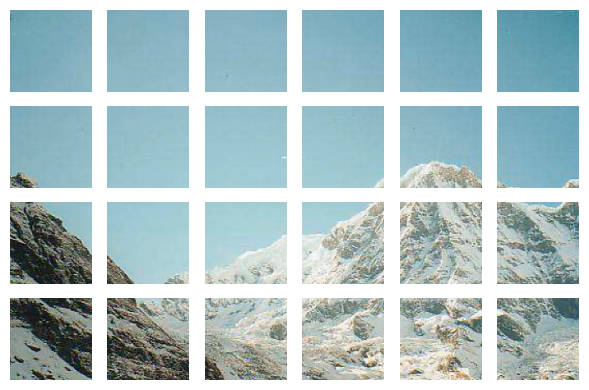

In [6]:
# 패치 이미지를 시각화
plt.figure(figsize=(6, 4))
for i, patch in enumerate(patches):
    plt.subplot(4, 6, i+1)
    plt.imshow(patch)
    plt.axis('off')
plt.tight_layout()
plt.show()

In [7]:
keypoints

[< cv2.KeyPoint 0x78a02f80ab20>,
 < cv2.KeyPoint 0x78a02f80abe0>,
 < cv2.KeyPoint 0x78a02f80ab80>,
 < cv2.KeyPoint 0x78a02f80ae20>,
 < cv2.KeyPoint 0x78a02f80aa00>,
 < cv2.KeyPoint 0x78a02f80aa30>,
 < cv2.KeyPoint 0x78a02f80b600>,
 < cv2.KeyPoint 0x78a02f80aaf0>,
 < cv2.KeyPoint 0x78a02f80a9d0>,
 < cv2.KeyPoint 0x78a02f80a970>,
 < cv2.KeyPoint 0x78a02f80a8e0>,
 < cv2.KeyPoint 0x78a02f80a880>,
 < cv2.KeyPoint 0x78a02f80aa90>,
 < cv2.KeyPoint 0x78a02f80a850>,
 < cv2.KeyPoint 0x78a02f80a820>,
 < cv2.KeyPoint 0x78a02f80a7f0>,
 < cv2.KeyPoint 0x78a02f80a730>,
 < cv2.KeyPoint 0x78a02f80a7c0>,
 < cv2.KeyPoint 0x78a02f80a8b0>,
 < cv2.KeyPoint 0x78a02f80a790>,
 < cv2.KeyPoint 0x78a02f80a940>,
 < cv2.KeyPoint 0x78a02f80a910>,
 < cv2.KeyPoint 0x78a02f80a9a0>,
 < cv2.KeyPoint 0x78a02f80a700>]

- image patch 생성 확인

In [8]:
np.array(patches).shape

(24, 100, 100, 4)

- keypoints 생성 확인

In [9]:
np.array(keypoints).shape

(24,)

- 결과 : image patch와 keypoints가 생성됨을 확인했습니다.

#### 1-2. 주어진 패치에서 ②image gradient, ③color histogram 디스크립터를 추출하는 함수를 각각 구현하고 그 결과를 확인해보세요.

- Image Gradient

In [10]:
def extract_gradients(patch):
    # 주어진 이미지(패치)의 gradient를 구하는 알고리즘을 구성하세요.
    # X, Y의 gradient 외에 여러 gradient 계열(코너 등)의 특징 모두 가능합니다.
    # cv2 라이브러리를 사용하셔도 됩니다.

    # 이미지를 그레이스케일로 변환
    gray_patch = cv2.cvtColor(patch, cv2.COLOR_BGR2GRAY)

    # X, Y 방향의 gradient 계산
    grad_x = cv2.Sobel(gray_patch, -1, 1, 0, ksize=3)
    grad_y = cv2.Sobel(gray_patch, -1, 0, 1, ksize=3)

    grads = (grad_x, grad_y)

    return grads

- 코드설명 :
1. extract_gradients 함수는 patch를 입력으로 받습니다.
2. 입력받은 patch를 그레이스케일로 변환합니다.
3. cv2.Sobel 함수를 통해 x축 방향 기울기, y축 방향 기울기를 각각 grad_x, grad_y에 저장합니다.
4. grad_x, grad_y를 튜플 형식으로 grads 객체에 저장합니다.
5. grads 객체를 반환합니다.

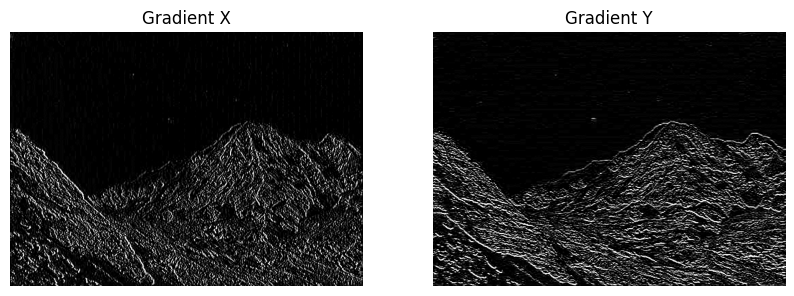

In [11]:
# gradient 이미지 출력
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(extract_gradients(image)[0], cv2.COLOR_BGR2RGB))
plt.title('Gradient X')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(extract_gradients(image)[1], cv2.COLOR_BGR2RGB))
plt.title('Gradient Y')
plt.axis('off')

plt.show()

- 결과 : image gradient의 결과가 제대로 생성됨을 확인했습니다.

- Color Historgram

In [12]:
def extract_color_histogram(patch):
    # 주어진 이미지(패치)를 HSV 색 공간으로 변환
    hsv_patch = cv2.cvtColor(patch, cv2.COLOR_BGR2HSV)

    # H(색상) 채널의 히스토그램 계산
    h_hist = cv2.calcHist([hsv_patch], [0], None, [180], [0, 180])

    return h_hist

- 코드설명 :
1. extract_color_histogram 함수를 정의합니다. 이 함수는 이미지 패치를 입력으로 받습니다.
2. 입력된 이미지 패치를 BGR에서 HSV 색 공간으로 변환합니다. cv2.cvtColor 함수를 사용하여 이미지를 원하는 색 공간으로 변환할 수 있습니다.
3. 변환된 이미지를 hsv_patch 변수에 저장합니다.
4. cv2.calcHist 함수를 사용하여 히스토그램을 생성합니다. 이 함수는 이미지, 채널, 마스크, 히스토그램의 크기(bin 수), 히스토그램 범위를 입력으로 받습니다.
5. 색상채널에 대한 히스토그램을 계산하기 위해 채널에 [0]을 입력합니다. 마스크는 사용하지 않기에 None을 입력합니다.
6. 히스토그램의 크기를 180으로 지정하고, 색상 값 범위를 0에서 180로 지정합니다.
7. 계산된 히스토그램을 h_hist 변수에 저장합니다.
8. 계산된 히스토그램을 h_hist를 반환합니다.

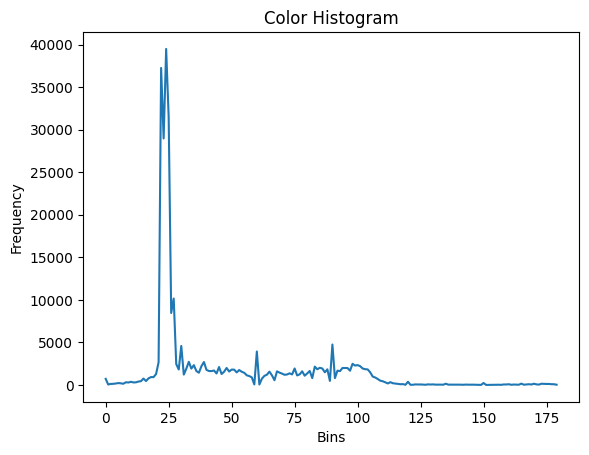

In [13]:
# 함수 호출
h_hist = extract_color_histogram(image)

# 히스토그램 출력
plt.plot(h_hist)
plt.title("Color Histogram")
plt.xlabel("Bins")
plt.ylabel("Frequency")
plt.show()

- 결과 : color histogram이 생성됨을 확인했습니다.

#### 1-3. 앞서 구한 ①image patch, ②image gradient, ③color histogram 디스크립터 특징을 이용하여, “paired images” 폴더에 있는 이미지들로 feature matching을 해보세요. (이 때, opencv의 Brute Force Matcher와 같은 built-in 함수를 사용하시면 됩니다) 또한, cv2.drawMatches(…)를 이용하여 결과를 나타내어 보세요.

##### Annapurna

In [14]:
# 이미지 파일 경로
image_path1 = '/content/drive/MyDrive/paired_images/annapurna_left_01.png'

# 이미지 불러오기
image_pil1 = Image.open(image_path1)
image_left_annapruna = np.array(image_pil1)

# 이미지 파일 경로
image_path2 = '/content/drive/MyDrive/paired_images/annapurna_right_01.png'

# 이미지 불러오기
image_pil2 = Image.open(image_path2)
image_right_annapruna = np.array(image_pil2)

- Descriptor 추출 & Matching

In [15]:
# 1) 임의의 두 페어 이미지를 읽고 패치를 추출
patches_01, keypoints_01 = make_patches(image_left_annapruna)
patches_02, keypoints_02 = make_patches(image_right_annapruna)

# 2-1) 리스트 생성
patch_features_01 = []
gradients_01 = []
histograms_01 = []

for patch in patches_01:
    # 기울기와 컬러 히스토그램을 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_01.append(np.array(patch_feature, dtype=np.float32))
    gradients_01.append(np.array(grad, dtype=np.float32))
    histograms_01.append(np.array(hist, dtype=np.float32))

# 2-2) 리스트 생성
patch_features_02 = []
gradients_02 = []
histograms_02 = []

for patch in patches_02:
    # 기울기와 컬러 히스토그램을 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_02.append(np.array(patch_feature, dtype=np.float32))
    gradients_02.append(np.array(grad, dtype=np.float32))
    histograms_02.append(np.array(hist, dtype=np.float32))

# 3) 추출된 특징을 이용하여, 매칭을 수행
matcher_patch = cv2.BFMatcher()
matcher_grad = cv2.BFMatcher()
matcher_hist = cv2.BFMatcher()

matches_patch = matcher_patch.match(np.array(patch_features_01), np.array(patch_features_02))
matches_grad = matcher_grad.match(np.array(gradients_01), np.array(gradients_02))
matches_hist = matcher_hist.match(np.array(histograms_01), np.array(histograms_02))

# 매칭 결과를 거리를 기준으로 정렬
matches_patch = sorted(matches_patch, key=lambda x: x.distance)[:50]
matches_grad = sorted(matches_grad, key=lambda x: x.distance)[:50]
matches_hist = sorted(matches_hist, key=lambda x: x.distance)[:50]

# 매칭된 지점을 시각화
draw_image_patch_annapruna = cv2.drawMatches(image_left_annapruna, keypoints_01, image_right_annapruna, keypoints_02, matches_patch, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_grad_annapruna = cv2.drawMatches(image_left_annapruna, keypoints_01, image_right_annapruna, keypoints_02, matches_grad, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_hist_annapruna = cv2.drawMatches(image_left_annapruna, keypoints_01, image_right_annapruna, keypoints_02, matches_hist, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 코드설명 :


    < Image Patch 생성 >
1. 1-1에서 생성한 make_patches 함수를 이용해 왼쪽 이미지, 오른쪽 이미지에 대해 각각 (patches_01, keypoints_01), (patches_02, keypoints_02)를 추출합니다.


    < Descriptor 추출 >
2. patch_features_01, gradients_01, histograms_01 리스트를 생성합니다. 해당 리스트에 각각 패치의 특징점, 기울기, 히스토그램을 저장하게 됩니다.
3. patches_01에 저장된 패치의 수 만큼 아래의 연산을 반복합니다.
4. 1-2에서 생성한 extract_gradients 함수를 사용하여 현재 패치의 기울기를 추출합니다.
5. 1-2에서 생성한 extract_color_histogram 함수를 사용하여 현재 패치의 컬러 히스토그램을 추출합니다.
6. 패치의 특징점, 기울기, 히스토그램을 각각 1차원 배열로 변환합니다.
7. 변환된 특징점, 기울기, 히스토그램을 patch_features_01, gradients_01, histograms_01 리스트에 추가합니다.
8. 위 2~7의 과정을 patches_02에 대해서도 반복합니다.


    < Matching >
9. cv2.BFMatcher()를 사용하여 세 개의 매처 객체(matcher_patch, matcher_grad, matcher_hist)를 생성합니다.
10. 각 매처 객체를 사용하여 해당하는 특징들 간의 매칭을 수행합니다. matcher_patch는 patch_features_01과 patch_features_02의 매칭을, matcher_grad는 gradients_01과 gradients_02의 매칭을, matcher_hist는 histograms_01과 histograms_02의 매칭을 수행합니다.
11. 각각의 매칭 결과를 거리를 기준으로 오름차순으로 정렬하고, 가장 가까운 50개의 매칭을 선택합니다.
12. cv2.drawMatches 함수를 사용하여 매칭된 지점을 시각화합니다. 각각의 결과는 draw_image_match, draw_image_grad, draw_image_hist 변수에 저장됩니다.

- 이미지 출력

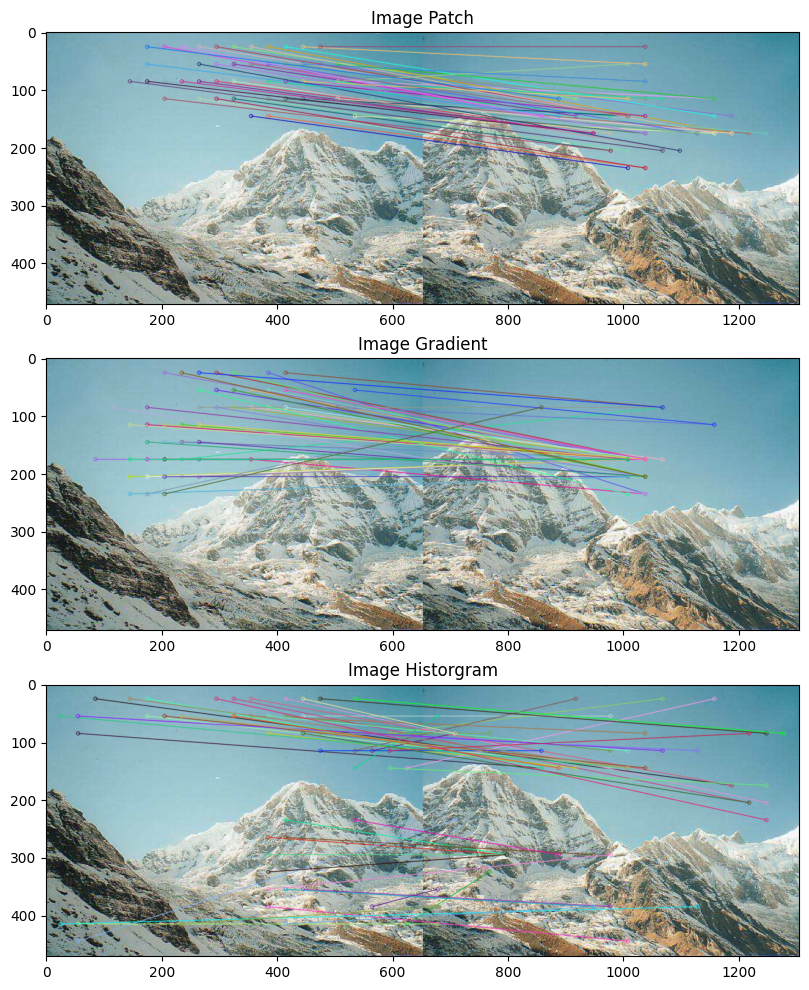

In [16]:
plt.figure(figsize=(10, 12))

# 원본 이미지 출력
plt.subplot(3, 1, 1)
plt.imshow(draw_image_patch_annapruna)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(3, 1, 2)
plt.imshow(draw_image_grad_annapruna)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(3, 1, 3)
plt.imshow(draw_image_hist_annapruna)
plt.title('Image Historgram')

plt.show()

##### bryce_01

In [17]:
# 이미지 파일 경로
image_path1 = '/content/drive/MyDrive/paired_images/bryce_left_01.png'

# 이미지 불러오기
image_pil1 = Image.open(image_path1)
image_left_bryce01 = np.array(image_pil1)

# 이미지 파일 경로
image_path2 = '/content/drive/MyDrive/paired_images/bryce_right_01.png'

# 이미지 불러오기
image_pil2 = Image.open(image_path2)
image_right_bryce01 = np.array(image_pil2)

- Descriptor 추출 & Matching

In [18]:
# 1) 임의의 두 페어 이미지를 읽고 패치를 추출
patches_01, keypoints_01 = make_patches(image_left_bryce01)
patches_02, keypoints_02 = make_patches(image_right_bryce01)

# 2-1) 리스트 생성
patch_features_01 = []
gradients_01 = []
histograms_01 = []

for patch in patches_01:
    # 기울기와 컬러 히스토그램을 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_01.append(np.array(patch_feature, dtype=np.float32))
    gradients_01.append(np.array(grad, dtype=np.float32))
    histograms_01.append(np.array(hist, dtype=np.float32))

# 2-2) 리스트 생성
patch_features_02 = []
gradients_02 = []
histograms_02 = []

for patch in patches_02:
    # 기울기와 컬러 히스토그램을 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_02.append(np.array(patch_feature, dtype=np.float32))
    gradients_02.append(np.array(grad, dtype=np.float32))
    histograms_02.append(np.array(hist, dtype=np.float32))

# 3) 추출된 특징을 이용하여, 매칭을 수행
matcher_patch = cv2.BFMatcher()
matcher_grad = cv2.BFMatcher()
matcher_hist = cv2.BFMatcher()

matches_patch = matcher_patch.match(np.array(patch_features_01), np.array(patch_features_02))
matches_grad = matcher_grad.match(np.array(gradients_01), np.array(gradients_02))
matches_hist = matcher_hist.match(np.array(histograms_01), np.array(histograms_02))

# 매칭 결과를 거리를 기준으로 정렬
matches_patch = sorted(matches_patch, key=lambda x: x.distance)[:50]
matches_grad = sorted(matches_grad, key=lambda x: x.distance)[:50]
matches_hist = sorted(matches_hist, key=lambda x: x.distance)[:50]

# 매칭된 지점을 시각화
draw_image_patch_bryce01 = cv2.drawMatches(image_left_bryce01, keypoints_01, image_right_bryce01, keypoints_02, matches_patch, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_grad_bryce01 = cv2.drawMatches(image_left_bryce01, keypoints_01, image_right_bryce01, keypoints_02, matches_grad, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_his_bryce01 = cv2.drawMatches(image_left_bryce01, keypoints_01, image_right_bryce01, keypoints_02, matches_hist, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

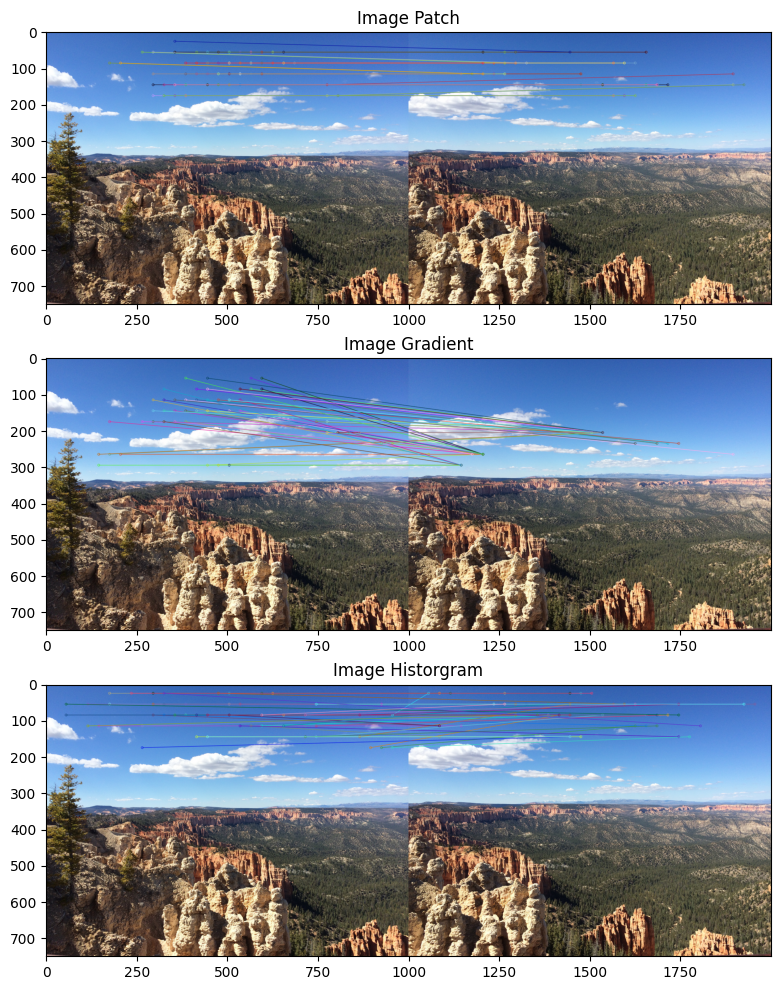

In [19]:
plt.figure(figsize=(10, 12))

# 원본 이미지 출력
plt.subplot(3, 1, 1)
plt.imshow(draw_image_patch_bryce01)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(3, 1, 2)
plt.imshow(draw_image_grad_bryce01)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(3, 1, 3)
plt.imshow(draw_image_his_bryce01)
plt.title('Image Historgram')

plt.show()

##### bryce_02

In [20]:
# 이미지 파일 경로
image_path1 = '/content/drive/MyDrive/paired_images/bryce_left_02.png'

# 이미지 불러오기
image_pil1 = Image.open(image_path1)
image_left_bryce02 = np.array(image_pil1)

# 이미지 파일 경로
image_path2 = '/content/drive/MyDrive/paired_images/bryce_right_02.png'

# 이미지 불러오기
image_pil2 = Image.open(image_path2)
image_right_bryce02 = np.array(image_pil2)

- Descriptor 추출 & Matching

In [21]:
# 1) 임의의 두 페어 이미지를 읽고 패치를 추출
patches_01, keypoints_01 = make_patches(image_left_bryce02)
patches_02, keypoints_02 = make_patches(image_right_bryce02)

# 2-1) 리스트 생성
patch_features_01 = []
gradients_01 = []
histograms_01 = []

for patch in patches_01:
    # 기울기와 컬러 히스토그램을 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환합
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_01.append(np.array(patch_feature, dtype=np.float32))
    gradients_01.append(np.array(grad, dtype=np.float32))
    histograms_01.append(np.array(hist, dtype=np.float32))

# 2-2) 리스트 생성
patch_features_02 = []
gradients_02 = []
histograms_02 = []

for patch in patches_02:
    # 기울기와 컬러 히스토그램을 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환합
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_02.append(np.array(patch_feature, dtype=np.float32))
    gradients_02.append(np.array(grad, dtype=np.float32))
    histograms_02.append(np.array(hist, dtype=np.float32))

# 3) 추출된 특징을 이용하여, 매칭을 수행
matcher_patch = cv2.BFMatcher()
matcher_grad = cv2.BFMatcher()
matcher_hist = cv2.BFMatcher()

matches_patch = matcher_patch.match(np.array(patch_features_01), np.array(patch_features_02))
matches_grad = matcher_grad.match(np.array(gradients_01), np.array(gradients_02))
matches_hist = matcher_hist.match(np.array(histograms_01), np.array(histograms_02))

# 매칭 결과를 거리를 기준으로 정렬
matches_patch = sorted(matches_patch, key=lambda x: x.distance)[:50]
matches_grad = sorted(matches_grad, key=lambda x: x.distance)[:50]
matches_hist = sorted(matches_hist, key=lambda x: x.distance)[:50]

# 매칭된 지점을 시각화
draw_image_patch_bryce02 = cv2.drawMatches(image_left_bryce02, keypoints_01, image_right_bryce02, keypoints_02, matches_patch, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_grad_bryce02 = cv2.drawMatches(image_left_bryce02, keypoints_01, image_right_bryce02, keypoints_02, matches_grad, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_hist_bryce02 = cv2.drawMatches(image_left_bryce02, keypoints_01, image_right_bryce02, keypoints_02, matches_hist, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

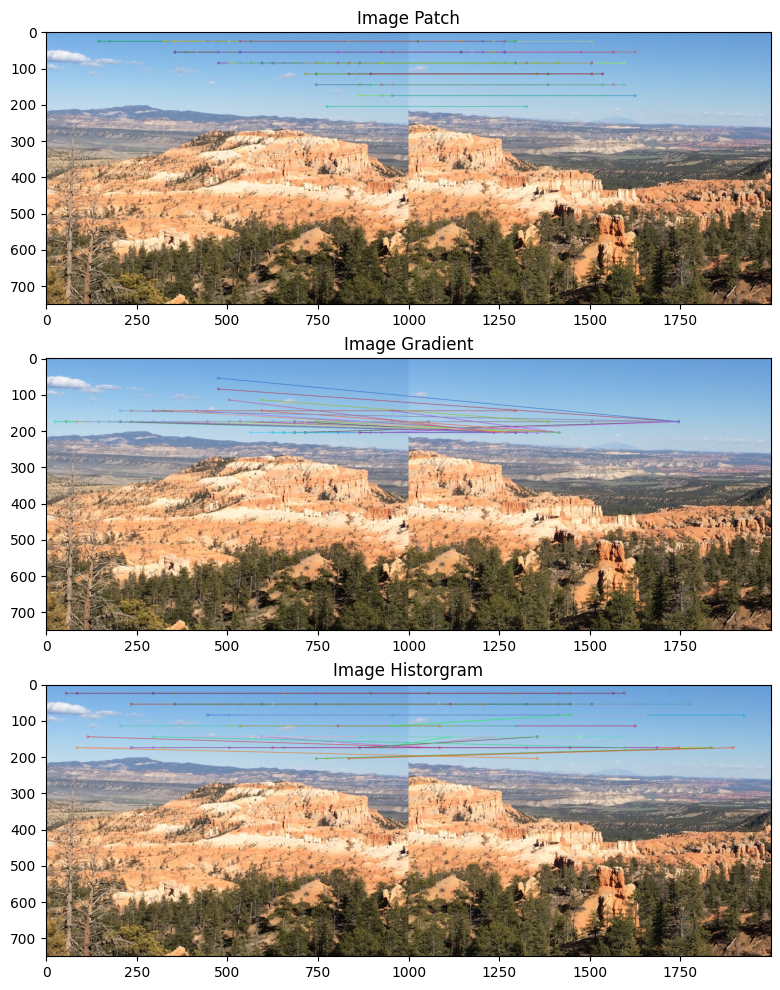

In [22]:
plt.figure(figsize=(10, 12))

# 원본 이미지 출력
plt.subplot(3, 1, 1)
plt.imshow(draw_image_patch_bryce02)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(3, 1, 2)
plt.imshow(draw_image_grad_bryce02)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(3, 1, 3)
plt.imshow(draw_image_hist_bryce02)
plt.title('Image Historgram')

plt.show()

##### bryce_03

In [23]:
# 이미지 파일 경로
image_path1 = '/content/drive/MyDrive/paired_images/bryce_left_03.png'

# 이미지 불러오기
image_pil1 = Image.open(image_path1)
image_left_bryce03 = np.array(image_pil1)

# 이미지 파일 경로
image_path2 = '/content/drive/MyDrive/paired_images/bryce_right_03.png'

# 이미지 불러오기
image_pil2 = Image.open(image_path2)
image_right_bryce03 = np.array(image_pil2)

- Descriptor 추출 & Matching

In [24]:
# 1) 임의의 두 페어 이미지를 읽고 패치를 추출
patches_01, keypoints_01 = make_patches(image_left_bryce03)
patches_02, keypoints_02 = make_patches(image_right_bryce03)

# 2-1) 리스트 생성
patch_features_01 = []
gradients_01 = []
histograms_01 = []

for patch in patches_01:
    # 기울기와 컬러 히스토그램을 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_01.append(np.array(patch_feature, dtype=np.float32))
    gradients_01.append(np.array(grad, dtype=np.float32))
    histograms_01.append(np.array(hist, dtype=np.float32))

# 2-2) 리스트 생성
patch_features_02 = []
gradients_02 = []
histograms_02 = []

for patch in patches_02:
    # 기울기와 컬러 히스토그램을 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_02.append(np.array(patch_feature, dtype=np.float32))
    gradients_02.append(np.array(grad, dtype=np.float32))
    histograms_02.append(np.array(hist, dtype=np.float32))

# 3) 추출된 특징을 이용하여, 매칭을 수행
matcher_patch = cv2.BFMatcher()
matcher_grad = cv2.BFMatcher()
matcher_hist = cv2.BFMatcher()

matches_patch = matcher_patch.match(np.array(patch_features_01), np.array(patch_features_02))
matches_grad = matcher_grad.match(np.array(gradients_01), np.array(gradients_02))
matches_hist = matcher_hist.match(np.array(histograms_01), np.array(histograms_02))

# 매칭 결과를 거리를 기준으로 정렬
matches_patch = sorted(matches_patch, key=lambda x: x.distance)[:50]
matches_grad = sorted(matches_grad, key=lambda x: x.distance)[:50]
matches_hist = sorted(matches_hist, key=lambda x: x.distance)[:50]

# 매칭된 지점을 시각화
draw_image_patch_bryce03 = cv2.drawMatches(image_left_bryce03, keypoints_01, image_right_bryce03, keypoints_02, matches_patch, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_grad_bryce03 = cv2.drawMatches(image_left_bryce03, keypoints_01, image_right_bryce03, keypoints_02, matches_grad, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_hist_bryce03 = cv2.drawMatches(image_left_bryce03, keypoints_01, image_right_bryce03, keypoints_02, matches_hist, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

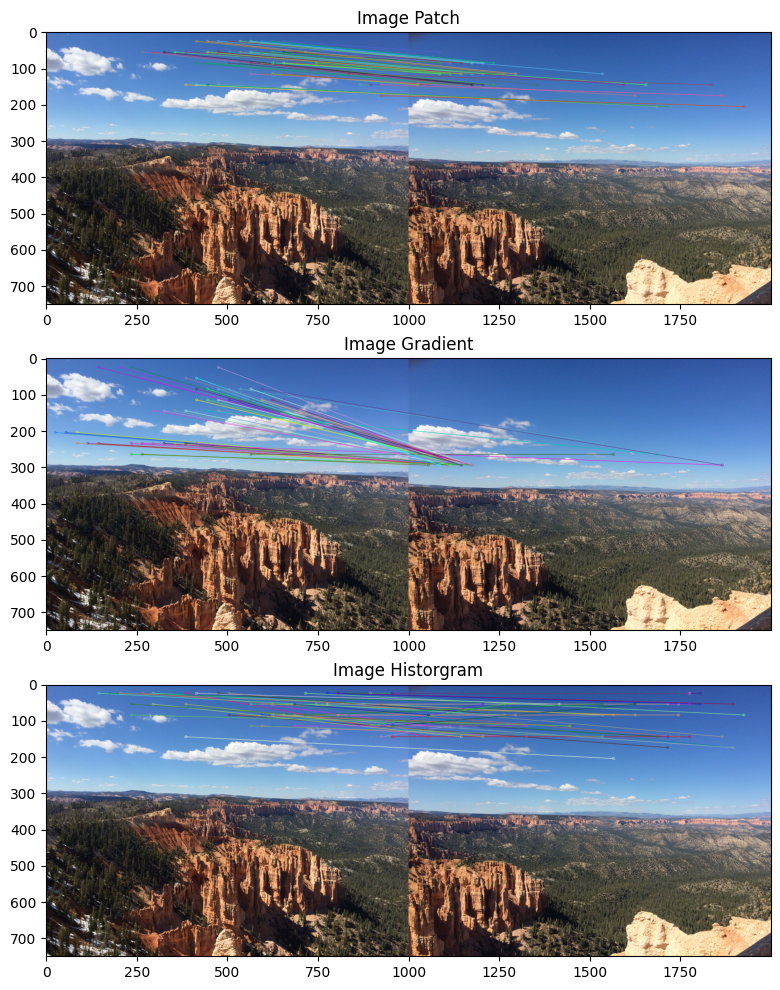

In [25]:
plt.figure(figsize=(10, 12))

# 원본 이미지 출력
plt.subplot(3, 1, 1)
plt.imshow(draw_image_patch_bryce03)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(3, 1, 2)
plt.imshow(draw_image_grad_bryce03)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(3, 1, 3)
plt.imshow(draw_image_hist_bryce03)
plt.title('Image Historgram')

plt.show()

##### grand_canyon_01

In [26]:
# 이미지 파일 경로
image_path1 = '/content/drive/MyDrive/paired_images/grand_canyon_left_01.png'

# 이미지 불러오기
image_pil1 = Image.open(image_path1)
image_left_grandcanyon01 = np.array(image_pil1)

# 이미지 파일 경로
image_path2 = '/content/drive/MyDrive/paired_images/grand_canyon_right_01.png'

# 이미지 불러오기
image_pil2 = Image.open(image_path2)
image_right_grandcanyon01 = np.array(image_pil2)

- Descriptor 추출 & Matching

In [27]:
# 1) 임의의 두 페어 이미지를 읽고 패치를 추출
patches_01, keypoints_01 = make_patches(image_left_grandcanyon01)
patches_02, keypoints_02 = make_patches(image_right_grandcanyon01)

# 2-1) 리스트 생성
patch_features_01 = []
gradients_01 = []
histograms_01 = []

for patch in patches_01:
    # 기울기와 컬러 히스토그램을 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_01.append(np.array(patch_feature, dtype=np.float32))
    gradients_01.append(np.array(grad, dtype=np.float32))
    histograms_01.append(np.array(hist, dtype=np.float32))

# 2-2) 리스트 생성
patch_features_02 = []
gradients_02 = []
histograms_02 = []

for patch in patches_02:
    # 기울기와 컬러 히스토그램을 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_02.append(np.array(patch_feature, dtype=np.float32))
    gradients_02.append(np.array(grad, dtype=np.float32))
    histograms_02.append(np.array(hist, dtype=np.float32))

# 3) 추출된 특징을 이용하여, 매칭 수행
matcher_patch = cv2.BFMatcher()
matcher_grad = cv2.BFMatcher()
matcher_hist = cv2.BFMatcher()

matches_patch = matcher_patch.match(np.array(patch_features_01), np.array(patch_features_02))
matches_grad = matcher_grad.match(np.array(gradients_01), np.array(gradients_02))
matches_hist = matcher_hist.match(np.array(histograms_01), np.array(histograms_02))

# 매칭 결과를 거리를 기준으로 정렬
matches_patch = sorted(matches_patch, key=lambda x: x.distance)[:50]
matches_grad = sorted(matches_grad, key=lambda x: x.distance)[:50]
matches_hist = sorted(matches_hist, key=lambda x: x.distance)[:50]

# 매칭된 지점을 시각화
draw_image_patch_grandcanyon01 = cv2.drawMatches(image_left_grandcanyon01, keypoints_01, image_right_grandcanyon01, keypoints_02, matches_patch, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_grad_grandcanyon01 = cv2.drawMatches(image_left_grandcanyon01, keypoints_01, image_right_grandcanyon01, keypoints_02, matches_grad, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_hist_grandcanyon01 = cv2.drawMatches(image_left_grandcanyon01, keypoints_01, image_right_grandcanyon01, keypoints_02, matches_hist, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

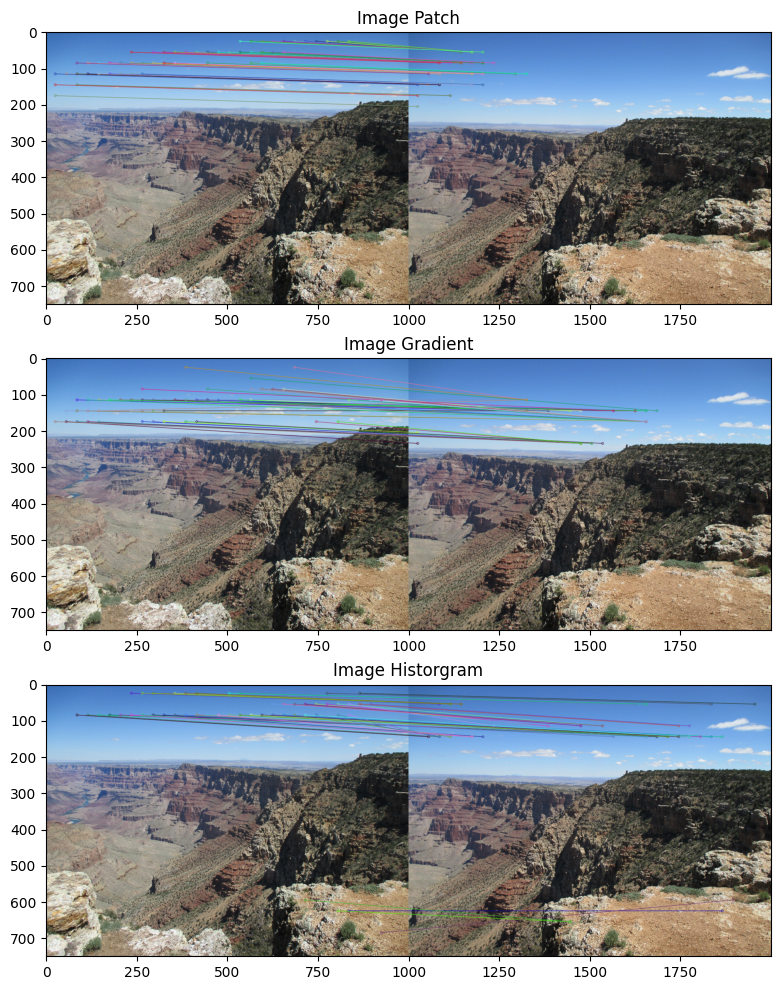

In [28]:
plt.figure(figsize=(10, 12))

# 원본 이미지 출력
plt.subplot(3, 1, 1)
plt.imshow(draw_image_patch_grandcanyon01)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(3, 1, 2)
plt.imshow(draw_image_grad_grandcanyon01)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(3, 1, 3)
plt.imshow(draw_image_hist_grandcanyon01)
plt.title('Image Historgram')

plt.show()

##### grand_canyon_02

In [29]:
# 이미지 파일 경로
image_path1 = '/content/drive/MyDrive/paired_images/grand_canyon_left_02.png'

# 이미지 불러오기
image_pil1 = Image.open(image_path1)
image_left_grandcanyon02 = np.array(image_pil1)

# 이미지 파일 경로
image_path2 = '/content/drive/MyDrive/paired_images/grand_canyon_right_02.png'

# 이미지 불러오기
image_pil2 = Image.open(image_path2)
image_right_grandcanyon02 = np.array(image_pil2)

- Descriptor 추출 & Matching

In [30]:
# 1) 임의의 두 페어 이미지를 읽고 패치 추출
patches_01, keypoints_01 = make_patches(image_left_grandcanyon02)
patches_02, keypoints_02 = make_patches(image_right_grandcanyon02)

# 2-1) 리스트 생성
patch_features_01 = []
gradients_01 = []
histograms_01 = []

for patch in patches_01:
    # 기울기와 컬러 히스토그램을 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_01.append(np.array(patch_feature, dtype=np.float32))
    gradients_01.append(np.array(grad, dtype=np.float32))
    histograms_01.append(np.array(hist, dtype=np.float32))

# 2-2) 리스트 생성
patch_features_02 = []
gradients_02 = []
histograms_02 = []

for patch in patches_02:
    # 기울기와 컬러 히스토그램 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_02.append(np.array(patch_feature, dtype=np.float32))
    gradients_02.append(np.array(grad, dtype=np.float32))
    histograms_02.append(np.array(hist, dtype=np.float32))

# 3) 추출된 특징을 이용하여, 매칭 수행
matcher_patch = cv2.BFMatcher()
matcher_grad = cv2.BFMatcher()
matcher_hist = cv2.BFMatcher()

matches_patch = matcher_patch.match(np.array(patch_features_01), np.array(patch_features_02))
matches_grad = matcher_grad.match(np.array(gradients_01), np.array(gradients_02))
matches_hist = matcher_hist.match(np.array(histograms_01), np.array(histograms_02))

# 매칭 결과를 거리를 기준으로 정렬
matches_patch = sorted(matches_patch, key=lambda x: x.distance)[:50]
matches_grad = sorted(matches_grad, key=lambda x: x.distance)[:50]
matches_hist = sorted(matches_hist, key=lambda x: x.distance)[:50]

# 매칭된 지점 시각화
draw_image_patch_grandcanyon02 = cv2.drawMatches(image_left_grandcanyon02, keypoints_01, image_right_grandcanyon02, keypoints_02, matches_patch, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_grad_grandcanyon02 = cv2.drawMatches(image_left_grandcanyon02, keypoints_01, image_right_grandcanyon02, keypoints_02, matches_grad, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_hist_grandcanyon02 = cv2.drawMatches(image_left_grandcanyon02, keypoints_01, image_right_grandcanyon02, keypoints_02, matches_hist, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

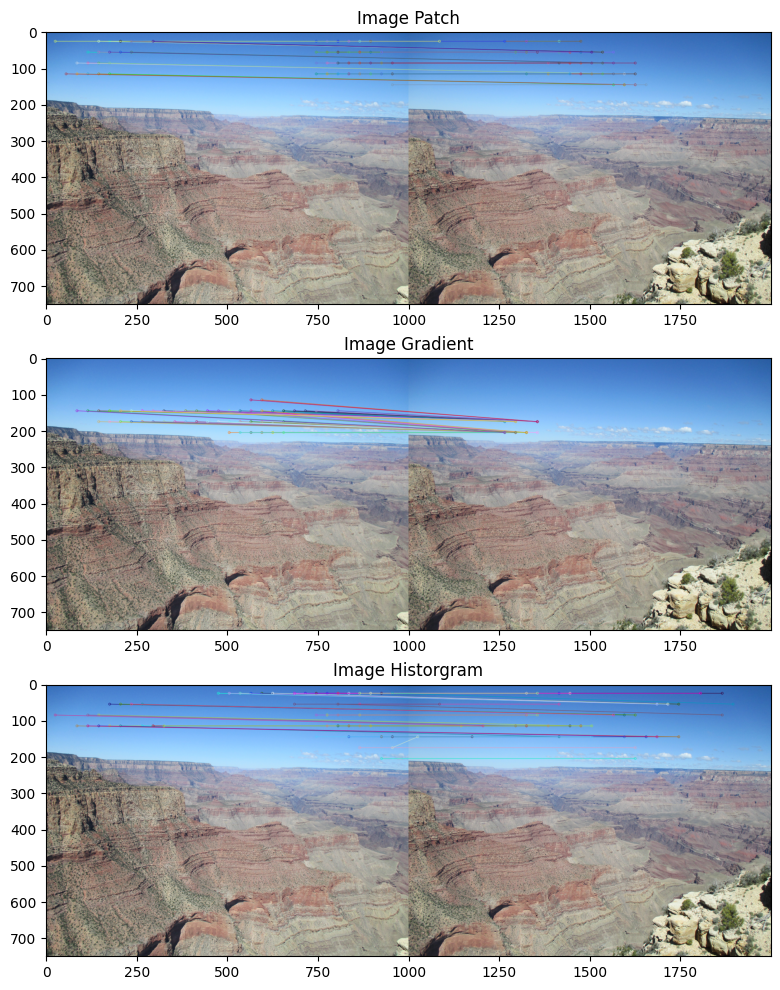

In [31]:
plt.figure(figsize=(10, 12))

# 원본 이미지 출력
plt.subplot(3, 1, 1)
plt.imshow(draw_image_patch_grandcanyon02)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(3, 1, 2)
plt.imshow(draw_image_grad_grandcanyon02)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(3, 1, 3)
plt.imshow(draw_image_hist_grandcanyon02)
plt.title('Image Historgram')

plt.show()

##### Scottsdale

In [32]:
# 이미지 파일 경로
image_path1 = '/content/drive/MyDrive/paired_images/scottsdale_left_01.png'

# 이미지 불러오기
image_pil1 = Image.open(image_path1)
image_left_scottsdale_left_01 = np.array(image_pil1)

# 이미지 파일 경로
image_path2 = '/content/drive/MyDrive/paired_images/scottsdale_right_01.png'

# 이미지 불러오기
image_pil2 = Image.open(image_path2)
image_right_scottsdale_right_01 = np.array(image_pil2)

- Descriptor 추출 & Matching

In [33]:
# 1) 임의의 두 페어 이미지를 읽고 패치 추출
patches_01, keypoints_01 = make_patches(image_left_scottsdale_left_01)
patches_02, keypoints_02 = make_patches(image_right_scottsdale_right_01)

# 2-1) 리스트 생성
patch_features_01 = []
gradients_01 = []
histograms_01 = []

for patch in patches_01:
    # 기울기와 컬러 히스토그램 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_01.append(np.array(patch_feature, dtype=np.float32))
    gradients_01.append(np.array(grad, dtype=np.float32))
    histograms_01.append(np.array(hist, dtype=np.float32))

# 2-2) 리스트 생성
patch_features_02 = []
gradients_02 = []
histograms_02 = []

for patch in patches_02:
    # 기울기와 컬러 히스토그램 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_02.append(np.array(patch_feature, dtype=np.float32))
    gradients_02.append(np.array(grad, dtype=np.float32))
    histograms_02.append(np.array(hist, dtype=np.float32))

# 3) 추출된 특징을 이용하여, 매칭 수행
matcher_patch = cv2.BFMatcher()
matcher_grad = cv2.BFMatcher()
matcher_hist = cv2.BFMatcher()

matches_patch = matcher_patch.match(np.array(patch_features_01), np.array(patch_features_02))
matches_grad = matcher_grad.match(np.array(gradients_01), np.array(gradients_02))
matches_hist = matcher_hist.match(np.array(histograms_01), np.array(histograms_02))

# 매칭 결과를 거리 기준으로 정렬
matches_patch = sorted(matches_patch, key=lambda x: x.distance)[:50]
matches_grad = sorted(matches_grad, key=lambda x: x.distance)[:50]
matches_hist = sorted(matches_hist, key=lambda x: x.distance)[:50]

# 매칭된 지점 시각화
draw_image_patch_scottsdale_left_01 = cv2.drawMatches(image_left_scottsdale_left_01, keypoints_01, image_right_scottsdale_right_01, keypoints_02, matches_patch, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_grad__scottsdale_left_01 = cv2.drawMatches(image_left_scottsdale_left_01, keypoints_01, image_right_scottsdale_right_01, keypoints_02, matches_grad, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_hist_scottsdale_left_01 = cv2.drawMatches(image_left_scottsdale_left_01, keypoints_01, image_right_scottsdale_right_01, keypoints_02, matches_hist, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

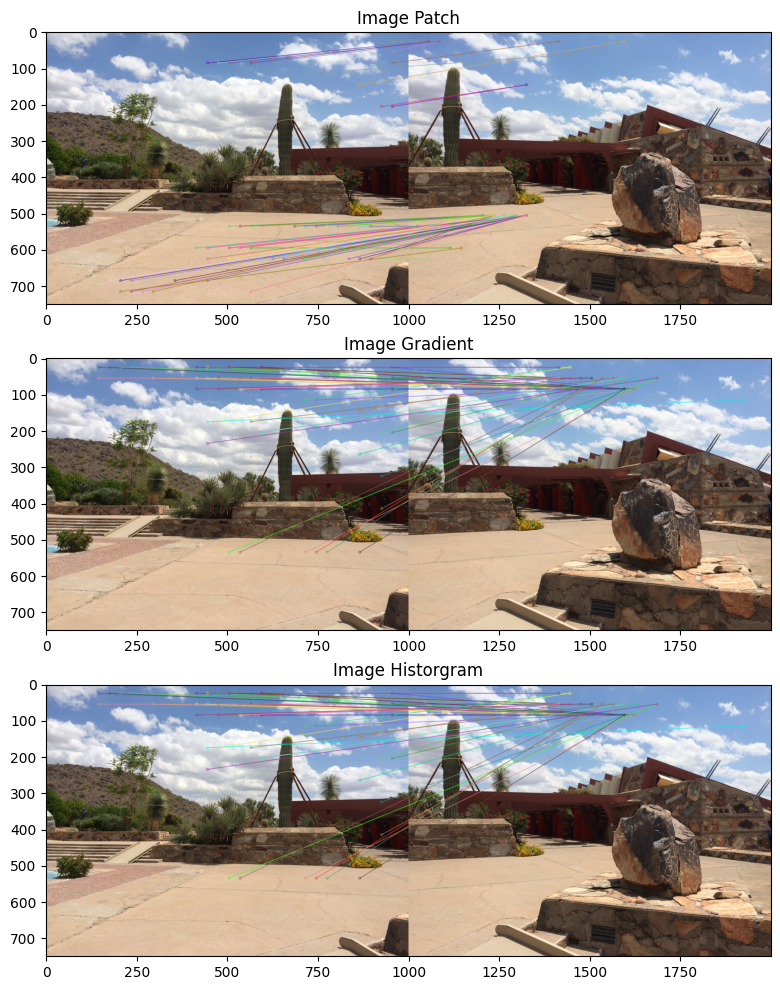

In [34]:
plt.figure(figsize=(10, 12))

# 원본 이미지 출력
plt.subplot(3, 1, 1)
plt.imshow(draw_image_patch_scottsdale_left_01)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(3, 1, 2)
plt.imshow(draw_image_grad__scottsdale_left_01)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(3, 1, 3)
plt.imshow(draw_image_grad__scottsdale_left_01)
plt.title('Image Historgram')

plt.show()

#### sedona

In [35]:
# 이미지 파일 경로
image_path1 = '/content/drive/MyDrive/paired_images/sedona_left_01.png'

# 이미지 불러오기
image_pil1 = Image.open(image_path1)
image_left_sedona_left_01 = np.array(image_pil1)

# 이미지 파일 경로
image_path2 = '/content/drive/MyDrive/paired_images/sedona_right_01.png'

# 이미지 불러오기
image_pil2 = Image.open(image_path2)
image_right_sedona_right_01 = np.array(image_pil2)

- Descriptor 추출 & Matching

In [36]:
# 1) 임의의 두 페어 이미지를 읽고 패치 추출
patches_01, keypoints_01 = make_patches(image_left_sedona_left_01)
patches_02, keypoints_02 = make_patches(image_right_sedona_right_01)

# 2-1) 리스트 생성
patch_features_01 = []
gradients_01 = []
histograms_01 = []

for patch in patches_01:
    # 기울기와 컬러 히스토그램 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_01.append(np.array(patch_feature, dtype=np.float32))
    gradients_01.append(np.array(grad, dtype=np.float32))
    histograms_01.append(np.array(hist, dtype=np.float32))

# 2-2) 리스트 생성
patch_features_02 = []
gradients_02 = []
histograms_02 = []

for patch in patches_02:
    # 기울기와 컬러 히스토그램 추출
    grad_x, grad_y = extract_gradients(patch)
    hist = extract_color_histogram(patch)

    # 특징점을 1차원 배열로 변환
    patch_feature = patch.flatten()
    grad = np.concatenate((grad_x.flatten(), grad_y.flatten()))
    hist = hist.flatten()

    patch_features_02.append(np.array(patch_feature, dtype=np.float32))
    gradients_02.append(np.array(grad, dtype=np.float32))
    histograms_02.append(np.array(hist, dtype=np.float32))

# 3) 추출된 특징을 이용하여, 매칭 수행
matcher_patch = cv2.BFMatcher()
matcher_grad = cv2.BFMatcher()
matcher_hist = cv2.BFMatcher()

matches_patch = matcher_patch.match(np.array(patch_features_01), np.array(patch_features_02))
matches_grad = matcher_grad.match(np.array(gradients_01), np.array(gradients_02))
matches_hist = matcher_hist.match(np.array(histograms_01), np.array(histograms_02))

# 매칭 결과를 거리 기준으로 정렬
matches_patch = sorted(matches_patch, key=lambda x: x.distance)[:50]
matches_grad = sorted(matches_grad, key=lambda x: x.distance)[:50]
matches_hist = sorted(matches_hist, key=lambda x: x.distance)[:50]

# 매칭된 지점 시각화
draw_image_patch_sedona_01 = cv2.drawMatches(image_left_sedona_left_01, keypoints_01, image_right_sedona_right_01, keypoints_02, matches_patch, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_grad_sedona_01 = cv2.drawMatches(image_left_sedona_left_01, keypoints_01, image_right_sedona_right_01, keypoints_02, matches_grad, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
draw_image_hist_sedona_01 = cv2.drawMatches(image_left_sedona_left_01, keypoints_01, image_right_sedona_right_01, keypoints_02, matches_hist, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

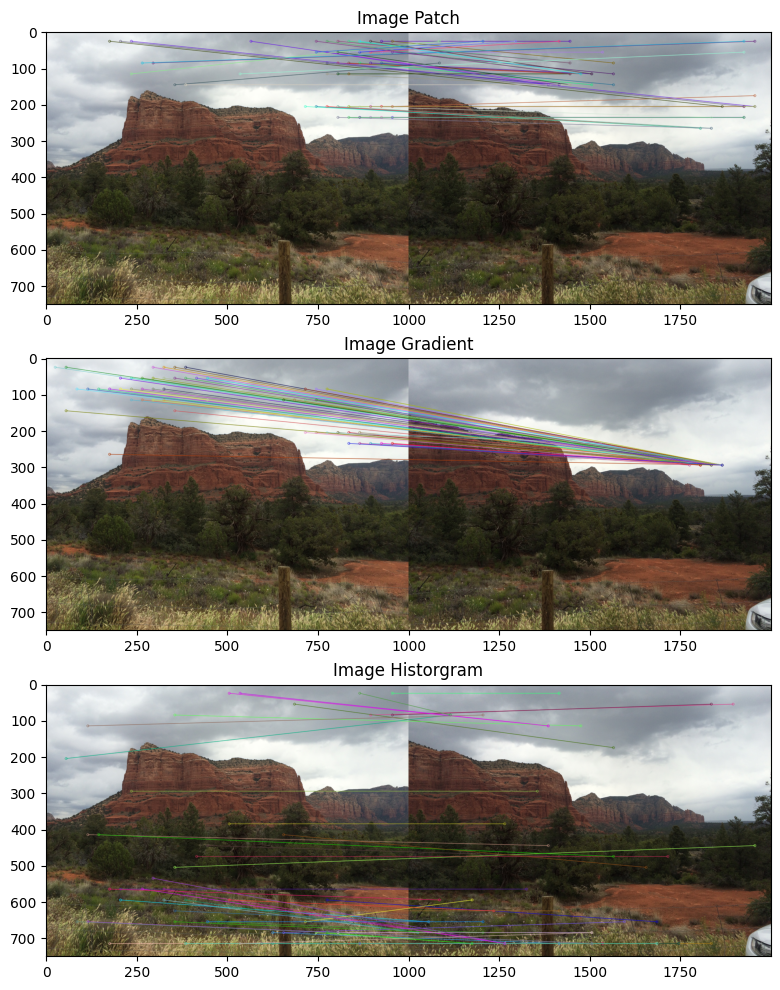

In [37]:
plt.figure(figsize=(10, 12))

# 원본 이미지 출력
plt.subplot(3, 1, 1)
plt.imshow(draw_image_patch_sedona_01)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(3, 1, 2)
plt.imshow(draw_image_grad_sedona_01)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(3, 1, 3)
plt.imshow(draw_image_hist_sedona_01)
plt.title('Image Historgram')

plt.show()

#### 1-4. OpenCV의 함수를 사용해 SIFT와 같은 더 나은 디스크립터를 추출해 feature matching을 수행하고 결과를 그려보세요. 앞서 직접 구현한 3가지 디스크립터와 결과를 비교해보세요.

##### Annapruna

- Descriptor 추출 & Matching

In [38]:
# SIFT 디스크립터 추출기 생성
sift = cv2.SIFT_create()

# SIFT를 이용하여 키포인트와 디스크립터 추출
keypoints_left_annapruna, descriptors_left_annapruna = sift.detectAndCompute(image_left_annapruna, None)
keypoints_right_annapruna, descriptors_right_annapruna = sift.detectAndCompute(image_right_annapruna, None)

# Brute-Force Matcher 생성
bf = cv2.BFMatcher()

# 디스크립터 매칭
matches = bf.knnMatch(descriptors_left_annapruna, descriptors_right_annapruna, k=2)

# 좋은 매칭을 선택
good_matches_annapruna = []
for m, n in matches:
    if m.distance < 0.75 * n.distance:
        good_matches_annapruna.append([m])

# 매칭 결과를 그리기 위한 이미지 생성
draw_image = cv2.drawMatchesKnn(image_left_annapruna, keypoints_left_annapruna, image_right_annapruna, keypoints_right_annapruna, good_matches_annapruna, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 코드설명 :
1. cv2.SIFT_create() 함수를 사용하여 SIFT 객체를 생성합니다.
2. sift.detectAndCompute() 함수를 사용하여 각 이미지에서 keypoints와 descriptor를 추출합니다.
3. cv2.BFMatcher() 함수를 사용하여 Brute-Force Matcher 객체를 생성합니다.
4. bf.knnMatch() 함수를 사용하여 왼쪽 이미지의 descriptor와 오른쪽 이미지의 descriptor 간의 매칭을 수행합니다. k 파라미터는 2로 설정하여, 각 descriptor마다 가장 가까운 2개의 이웃을 찾도록 합니다.
5. 디스크립터 매칭 결과 중에서, 거리 비율 테스트를 통과한 매칭만을 선택하여 good_matches 리스트에 저장합니다. 거리 비율 테스트는 가장 가까운 이웃 m과 그 다음 이웃 n과 descriptor간의 거리 비율이 0.75보다 작을 경우의 가장 가까운 이웃 m을 선택합니다.
6. cv2.drawMatchesKnn() 함수를 사용하여 좋은 매칭을 시각화한 이미지를 생성합니다. 각 매칭은 선으로 연결되어 시각화됩니다.

- 이미지 추출

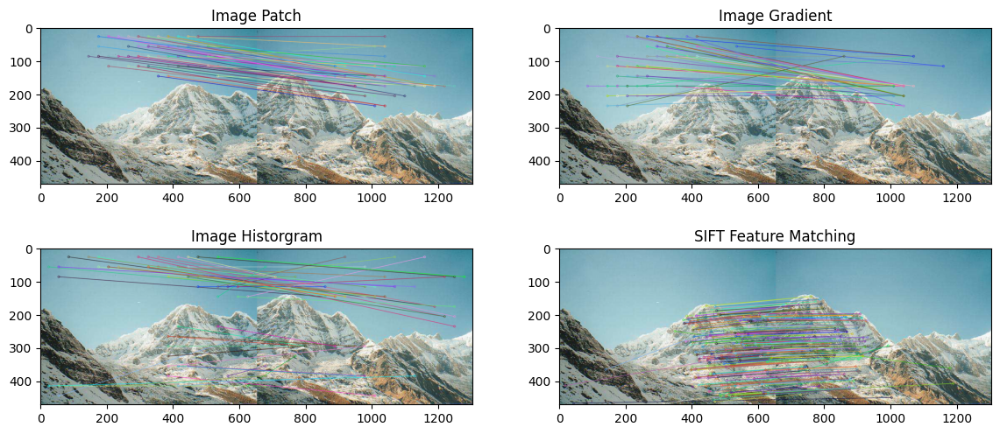

In [39]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.imshow(draw_image_patch_annapruna)
plt.title('Image Patch')

# 원본 이미지 출력
plt.subplot(2, 2, 2)
plt.imshow(draw_image_grad_annapruna)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(2, 2, 3)
plt.imshow(draw_image_hist_annapruna)
plt.title('Image Historgram')

plt.subplot(2, 2, 4)
plt.imshow(draw_image)
plt.title('SIFT Feature Matching')
plt.show()

- 결과 :
1. Image Patch : 매칭 선이 산이 아니라 하늘에 나타나며, 선의 기울기가 비슷하게 나타납니다.
2. Image Gradient : 매칭 선이 하늘에 나타나며, 선의 기울기가 다양하게 나타납니다. Image Patch에 비해 생성된 매칭 선의 개수가 적어 보입니다.
3. Image Histogram : 매칭 선이 하늘 뿐 아니라 산에도 나타납니다. 다만 아주 소수 이며, 산에 나타나는 매칭 선은 Image Patch와 Image Gradient에 비해 정확해 보입니다.
4. SIFT Feature Matching : Image Patch, Image Gradient, Image Histogram 보다 훨씬 정확한 매칭 선이 형성됨을 확인했습니다. 주요 객체인 산을 중심으로 오른쪽 이미지와 왼쪽 이미지가 겹치는 곳에 매칭선이 대량으로 형성되었습니다.

##### bryce_01

- Descriptor 추출 & Matching

In [40]:
# SIFT 디스크립터 추출기 생성
sift = cv2.SIFT_create()

# SIFT를 이용하여 키포인트와 디스크립터 추출
keypoints_left_bryce01, descriptors_left_bryce01 = sift.detectAndCompute(image_left_bryce01, None)
keypoints_right_bryce01, descriptors_right_bryce01 = sift.detectAndCompute(image_right_bryce01, None)

# Brute-Force Matcher 생성
bf = cv2.BFMatcher()

# 디스크립터 매칭
matches = bf.knnMatch(descriptors_left_bryce01, descriptors_right_bryce01, k=2)

# 좋은 매칭을 선택
good_matches_bryce01 = []
for m, n in matches:
    if m.distance < 0.75 * n.distance:
        good_matches_bryce01.append([m])

# 매칭 결과를 그리기 위한 이미지 생성
draw_image = cv2.drawMatchesKnn(image_left_bryce01, keypoints_left_bryce01, image_right_bryce01, keypoints_right_bryce01, good_matches_bryce01, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

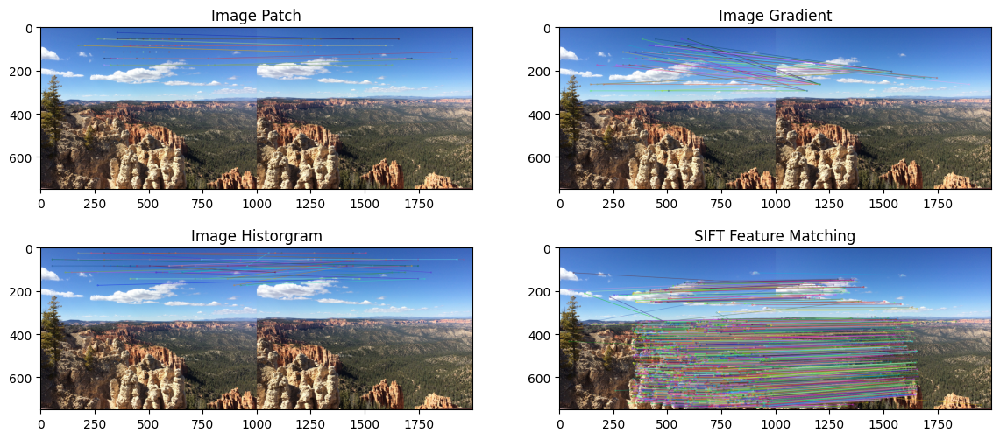

In [41]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.imshow(draw_image_patch_bryce01)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(2, 2, 2)
plt.imshow(draw_image_grad_bryce01)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(2, 2, 3)
plt.imshow(draw_image_his_bryce01)
plt.title('Image Historgram')

plt.subplot(2, 2, 4)
plt.imshow(draw_image)
plt.title('SIFT Feature Matching')
plt.show()

- 결과 :
1. Image Patch : 매칭 선이 하늘에 위치해있으며, 기울기가 거의 없는 수평한 선이 관찰됩니다.
2. Image Gradient : 오른쪽 사진의 소수의 지점과 왼쪽 사진의 다수 지점과 매칭되는 것이 관찰됩니다. Image Patch 보다 다양한 기울기의 매칭 선이 관찰됩니다.
3. Image Histogram : 매칭 선이 하늘에 위치해있으며, 기울기가 거의 없는 수평한 선이 관찰됩니다. 기울기가 나타나는 극소수의 선을 제외하면 Image Patch의 결과와 유사해 보입니다.
4. SIFT Feature Matching : SIFT를 통해 앞서 Image Patch, Image Gradient, Image Histogram 보다 훨씬 정확한 매칭 선이 형성됨을 확인했습니다. 수많은 매칭 선이 골짜기를 중심으로 형성되었습니다. 또한, 하늘의 구름에도 많은 매칭 선이 형성되었습니다. 이렇게 형성된 매칭선은 매우 정확해 보입니다.

##### bryce_02

- Descriptor 추출 & Matching

In [42]:
# SIFT 디스크립터 추출기 생성
sift = cv2.SIFT_create()

# SIFT를 이용하여 키포인트와 디스크립터 추출
keypoints_left_bryce02, descriptors_left_bryce02 = sift.detectAndCompute(image_left_bryce02, None)
keypoints_right_bryce02, descriptors_right_bryce02 = sift.detectAndCompute(image_right_bryce02, None)

# Brute-Force Matcher 생성
bf = cv2.BFMatcher()

# 디스크립터 매칭
matches = bf.knnMatch(descriptors_left_bryce02, descriptors_right_bryce02, k=2)

# 좋은 매칭을 선택
good_matches_bryce02 = []
for m, n in matches:
    if m.distance < 0.75 * n.distance:
        good_matches_bryce02.append([m])

# 매칭 결과를 그리기 위한 이미지 생성
draw_image = cv2.drawMatchesKnn(image_left_bryce02, keypoints_left_bryce02, image_right_bryce02, keypoints_right_bryce02, good_matches_bryce02, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

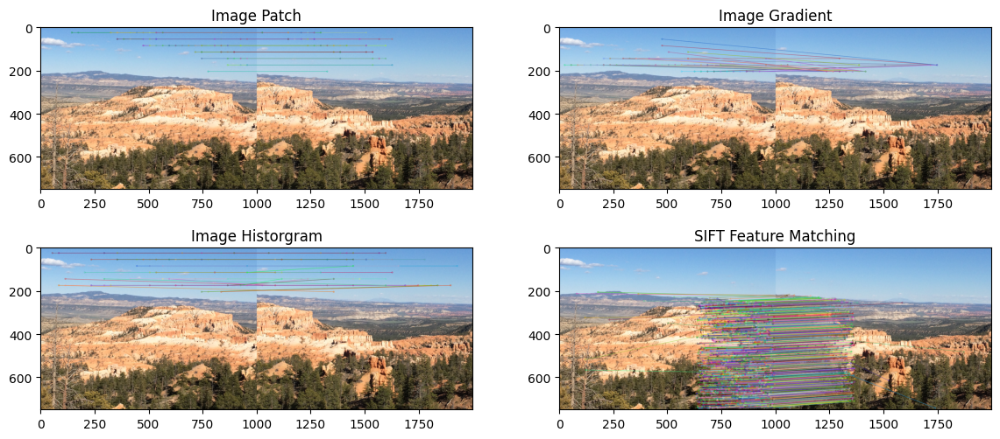

In [43]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.imshow(draw_image_patch_bryce02)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(2, 2, 2)
plt.imshow(draw_image_grad_bryce02)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(2, 2, 3)
plt.imshow(draw_image_hist_bryce02)
plt.title('Image Historgram')

plt.subplot(2, 2, 4)
plt.imshow(draw_image)
plt.title('SIFT Feature Matching')
plt.show()

- 결과 :
1. Image Patch : 매칭 선이 수평에 가까운 모습을 보이고 있습니다. 또한, 생성된 매칭 선의 개수가 매우 적어보입니다.
2. Image Gradient : Image Patch에 비해 다양한 매칭 선이 형성되었으나, 산이 아니라 하늘에 형성됨을 확인했습니다. 또한, 오른쪽 이미지 소수의 점에만 매칭선이 형성되고 있습니다.
3. Image Histogram : Image Patch 만큼은 아니지만 매칭선이 수평에 가까운 모습을 보여줍니다. 생성된 매칭 선의 개수가 매우 적어보입니다.
4. SIFT Feature Matching : SIFT를 통해 앞서 Image Patch, Image Gradient, Image Histogram 보다 훨씬 정확한 매칭 선이 형성됨을 확인했습니다. 산을 중심으로 수많은 매칭 선이 형성되었습니다.

##### bryce_03

- Descriptor 추출 & Matching

In [44]:
# SIFT 디스크립터 추출기 생성
sift = cv2.SIFT_create()

# SIFT를 이용하여 키포인트와 디스크립터 추출
keypoints_left_bryce03, descriptors_left_bryce03 = sift.detectAndCompute(image_left_bryce03, None)
keypoints_right_bryce03, descriptors_right_bryce03 = sift.detectAndCompute(image_right_bryce03, None)

# Brute-Force Matcher 생성
bf = cv2.BFMatcher()

# 디스크립터 매칭
matches = bf.knnMatch(descriptors_left_bryce03, descriptors_right_bryce03, k=2)

# 좋은 매칭을 선택
good_matches_bryce03 = []
for m, n in matches:
    if m.distance < 0.75 * n.distance:
        good_matches_bryce03.append([m])

# 매칭 결과를 그리기 위한 이미지 생성
draw_image = cv2.drawMatchesKnn(image_left_bryce03, keypoints_left_bryce03, image_right_bryce03, keypoints_right_bryce03, good_matches_bryce03, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

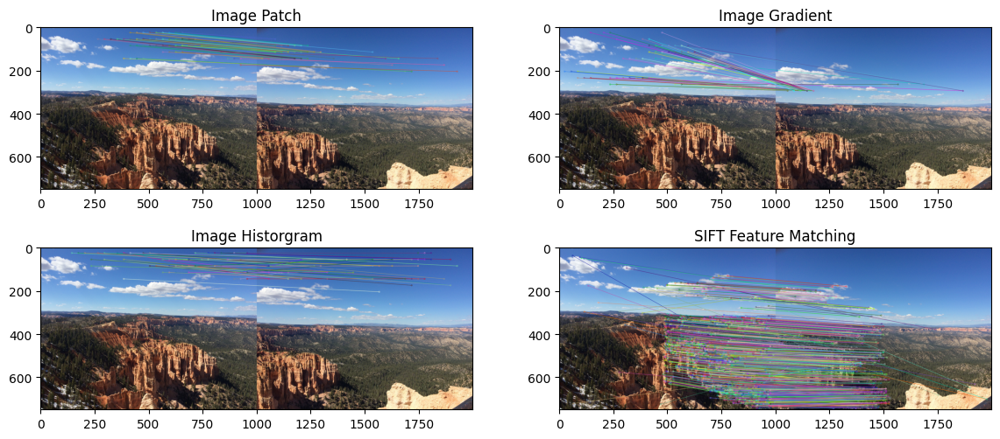

In [45]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.imshow(draw_image_patch_bryce03)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(2, 2, 2)
plt.imshow(draw_image_grad_bryce03)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(2, 2, 3)
plt.imshow(draw_image_hist_bryce03)
plt.title('Image Historgram')

plt.subplot(2, 2, 4)
plt.imshow(draw_image)
plt.title('SIFT Feature Matching')
plt.show()

- 결과 :
1. Image Patch : 매칭 선이 하늘을 중심으로 생성되었습니다.
2. Image Gradient : 오른쪽 사진 소수의 특징점과 왼쪽 사진의 다수의 특징점이 매칭이 되는 것이 관찰되었습니다.
3. Image Histogram : Image Patch와 Image Gradient에 비해 다양하게 매칭되었으나, 하늘쪽에만 치중하게 매칭되어 있습니다.
4. SIFT Feature Matching : SIFT를 통해 앞서 Image Patch, Image Gradient, Image Histogram 보다 훨씬 정확한 매칭 선이 형성됨을 확인했습니다. 짜기를 중심으로 수많은 매칭 선이 형성되었습니다. 하늘의 구름에도 일부 매칭 선이 형성되었습니다. 하늘에 형성된 소수의 매칭선은 부정확해 보이는 것도 존재합니다.

##### grand_canyon_01

- Descriptor 추출 & Matching

In [46]:
# SIFT 디스크립터 추출기 생성
sift = cv2.SIFT_create()

# SIFT를 이용하여 키포인트와 디스크립터 추출
keypoints_left_grandcanyon01, descriptors_left_grandcanyon01 = sift.detectAndCompute(image_left_grandcanyon01, None)
keypoints_right_grandcanyon01, descriptors_right_grandcanyon01 = sift.detectAndCompute(image_right_grandcanyon01, None)

# Brute-Force Matcher 생성
bf = cv2.BFMatcher()

# 디스크립터 매칭
matches = bf.knnMatch(descriptors_left_grandcanyon01, descriptors_right_grandcanyon01, k=2)

# 좋은 매칭을 선택
good_matches_grandcanyon01 = []
for m, n in matches:
    if m.distance < 0.75 * n.distance:
        good_matches_grandcanyon01.append([m])

# 매칭 결과를 그리기 위한 이미지 생성
draw_image = cv2.drawMatchesKnn(image_left_grandcanyon01, keypoints_left_grandcanyon01, image_right_grandcanyon01, keypoints_right_grandcanyon01, good_matches_grandcanyon01, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

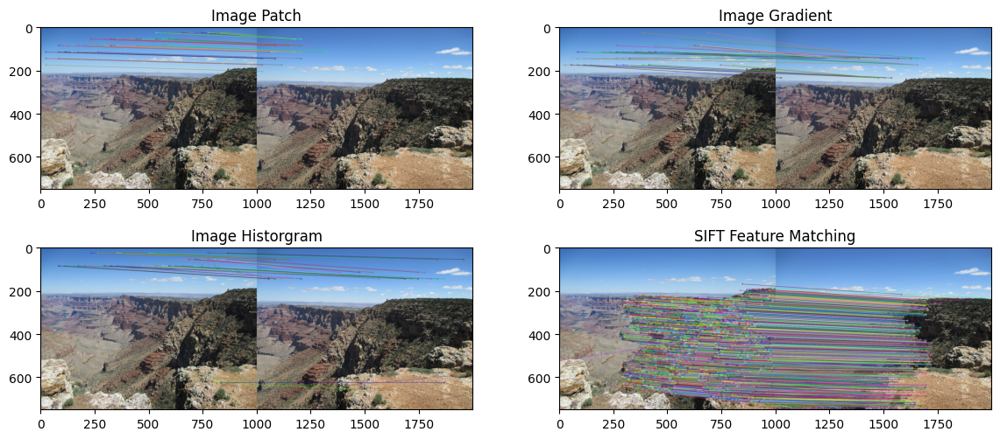

In [47]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.imshow(draw_image_patch_grandcanyon01)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(2, 2, 2)
plt.imshow(draw_image_grad_grandcanyon01)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(2, 2, 3)
plt.imshow(draw_image_hist_grandcanyon01)
plt.title('Image Historgram')

plt.subplot(2, 2, 4)
plt.imshow(draw_image)
plt.title('SIFT Feature Matching')
plt.show()

- 결과 :
1. Image Patch : 여러 개의 매칭 선이 겹쳐 소수의 선만 형성된 것으로 보이고 있습니다. 기울기가 거의 없는 평행한 매칭선이 다수 형성되었습니다.
2. Image Gradient : 오른쪽 사진 소수의 특징점과 왼쪽 사진의 다수의 특징점이 매칭이 되는 것이 관찰됩니다. 기울기가 거의 없는 평행한 매칭선이 다수 형성되었습니다.
3. Image Histogram : 기울기가 거의 없는 선이 자주 관찰되며, 하늘 뿐만 아니라 땅에도 소수의 매칭 선이 관찰됩니다. 땅에서도 기울기가 거의 없는 평행한 매칭선이 형성되었습니다.
4. SIFT Feature Matching : SIFT를 통해 앞서 Image Patch, Image Gradient, Image Histogram 보다 훨씬 정확한 매칭 선이 형성됨을 확인했습니다. 이미지의 골짜기가 전부 가려질 정도로, 골짜기를 중심으로 수많은 매칭 선이 형성되었습니다. 형성된 매칭 선은 매우 정확해 보입니다.

##### grand_canyon_02

- Descriptor 추출 & Matching

In [48]:
# SIFT 디스크립터 추출기 생성
sift = cv2.SIFT_create()

# SIFT를 이용하여 키포인트와 디스크립터 추출
keypoints_left_grandcanyon02, descriptors_left_grandcanyon02 = sift.detectAndCompute(image_left_grandcanyon02, None)
keypoints_right_grandcanyon02, descriptors_right_grandcanyon02 = sift.detectAndCompute(image_right_grandcanyon02, None)

# Brute-Force Matcher 생성
bf = cv2.BFMatcher()

# 디스크립터 매칭
matches = bf.knnMatch(descriptors_left_grandcanyon02, descriptors_right_grandcanyon02, k=2)

# 좋은 매칭을 선택
good_matches_grandcanyon02 = []
for m, n in matches:
    if m.distance < 0.75 * n.distance:
        good_matches_grandcanyon02.append([m])

# 매칭 결과를 그리기 위한 이미지 생성
draw_image = cv2.drawMatchesKnn(image_left_grandcanyon02, keypoints_left_grandcanyon02, image_right_grandcanyon02, keypoints_right_grandcanyon02, good_matches_grandcanyon02, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

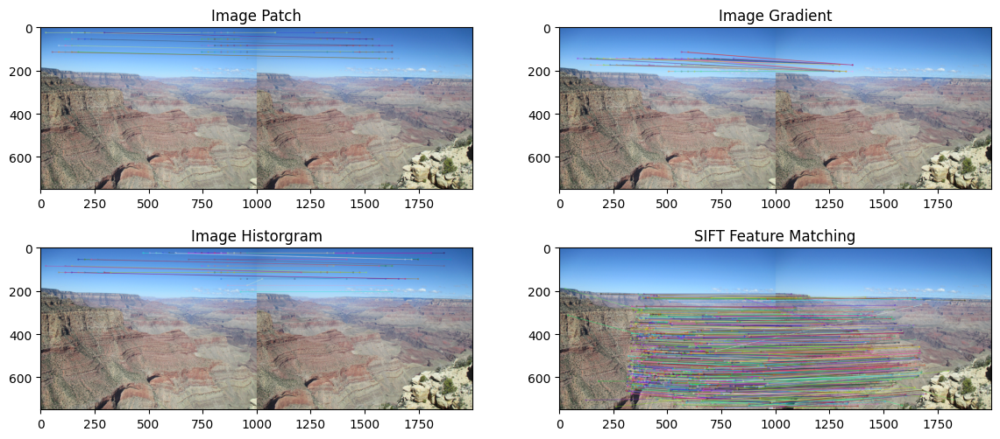

In [49]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.imshow(draw_image_patch_grandcanyon02)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(2, 2, 2)
plt.imshow(draw_image_grad_grandcanyon02)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(2, 2, 3)
plt.imshow(draw_image_hist_grandcanyon02)
plt.title('Image Historgram')

plt.subplot(2, 2, 4)
plt.imshow(draw_image)
plt.title('SIFT Feature Matching')
plt.show()

- 결과 :
1. Image Patch : 수평에 가까운 매칭 선이 하늘에 형성되었습니다.
2. Image Gradient : 오른쪽 사진 소수의 특징점과 왼쪽 사진의 다수의 특징점이 매칭이 되는 것이 관찰됩니다.
3. Image Histogram : Image Patch와 거의 유사한 매칭 선이 형성되었습니다.
4. SIFT Feature Matching : SIFT를 통해 앞서 Image Patch, Image Gradient, Image Histogram 보다 훨씬 정확한 매칭 선이 형성됨을 확인했습니다. 골짜기를 중심으로 수많은 매칭 선이 형성되었습니다. 해당 매칭 선은 매우 정확해보입니다. 하늘에만 매칭 선이 형성된 타 방법과는 상당히 대조됩니다.

##### scottsdale

- Descriptor 추출 & Matching

In [50]:
# SIFT 디스크립터 추출기 생성
sift = cv2.SIFT_create()

# SIFT를 이용하여 키포인트와 디스크립터 추출
keypoints_left_scottsdale, descriptors_left_scottsdale = sift.detectAndCompute(image_left_scottsdale_left_01, None)
keypoints_right_scottsdale, descriptors_right_scottsdale = sift.detectAndCompute(image_right_scottsdale_right_01, None)

# Brute-Force Matcher 생성
bf = cv2.BFMatcher()

# 디스크립터 매칭
matches = bf.knnMatch(descriptors_left_scottsdale, descriptors_right_scottsdale, k=2)

# 좋은 매칭을 선택
good_matches_scottsdale = []
for m, n in matches:
    if m.distance < 0.75 * n.distance:
        good_matches_scottsdale.append([m])

# 매칭 결과를 그리기 위한 이미지 생성
draw_image = cv2.drawMatchesKnn(image_left_scottsdale_left_01, keypoints_left_scottsdale, image_right_scottsdale_right_01, keypoints_right_scottsdale, good_matches_scottsdale, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

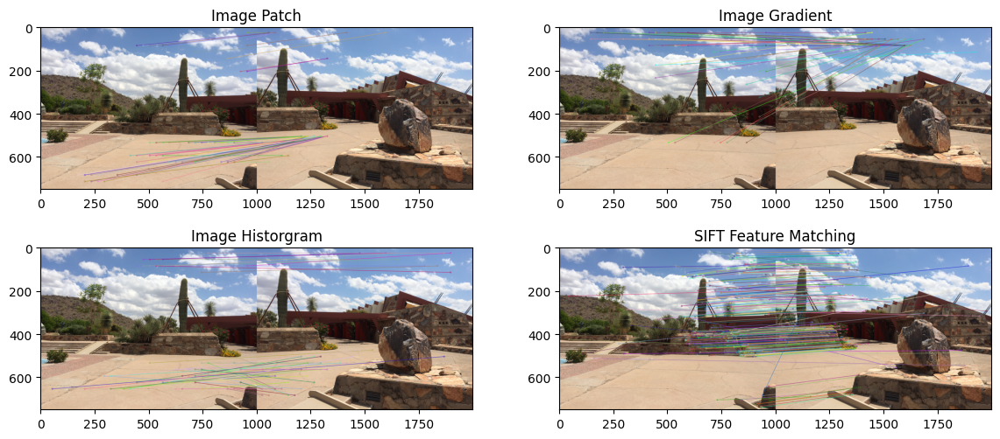

In [51]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.imshow(draw_image_patch_scottsdale_left_01)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(2, 2, 2)
plt.imshow(draw_image_grad__scottsdale_left_01)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(2, 2, 3)
plt.imshow(draw_image_hist_scottsdale_left_01)
plt.title('Image Historgram')

plt.subplot(2, 2, 4)
plt.imshow(draw_image)
plt.title('SIFT Feature Matching')
plt.show()

- 결과 :
1. Image Patch : 매칭 선이 하늘과 땅에 형성되었습니다. 구조물에는 매칭선이 생성되지 않았습니다. 매칭 선의 대부분이 오른쪽 사진의 땅에 형성되었습니다.
2. Image Gradient : 오른쪽 사진 소수의 특징점과 왼쪽 사진의 다수의 특징점이 매칭이 되는 것이 관찰됩니다. Image Patch에서는 땅을 중심으로 매칭선이 형성되었는데, 여기서는 하늘을 중심으로 형성되었습니다.
3. Image Histogram : 하늘과 땅에 매칭 선이 형성되었습니다. 땅에 형성된 매칭 선의 기울기가 매우 다양해 보입니다. 산에 형성된 매칭 선은 수평에 가깝습니다.
4. SIFT Feature Matching : SIFT를 통해 앞서 Image Patch, Image Gradient, Image Histogram 보다 훨씬 정확한 매칭 선이 형성됨을 확인했습니다. 다만, 앞의 grandcanyon02 이미지와 비교했을 때, SIFT를 통해 형성된 매칭 선의 수가 상당히 적어 보입니다. 또한, 일부 부정확해 보이는 매칭 선도 관찰됩니다.

##### sedona

- Descriptor 추출 & Matching

In [52]:
# SIFT 디스크립터 추출기 생성
sift = cv2.SIFT_create()

# SIFT를 이용하여 키포인트와 디스크립터 추출
keypoints_left_sedona, descriptors_left_sedona = sift.detectAndCompute(image_left_sedona_left_01, None)
keypoints_right_sedona, descriptors_right_sedona = sift.detectAndCompute(image_right_sedona_right_01, None)

# Brute-Force Matcher 생성
bf = cv2.BFMatcher()

# 디스크립터 매칭
matches = bf.knnMatch(descriptors_left_sedona, descriptors_right_sedona, k=2)

# 좋은 매칭을 선택
good_matches_sedona = []
for m, n in matches:
    if m.distance < 0.75 * n.distance:
        good_matches_sedona.append([m])

# 매칭 결과를 그리기 위한 이미지 생성
draw_image = cv2.drawMatchesKnn(image_left_sedona_left_01, keypoints_left_sedona, image_right_sedona_right_01, keypoints_right_sedona, good_matches_sedona, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

- 이미지 출력

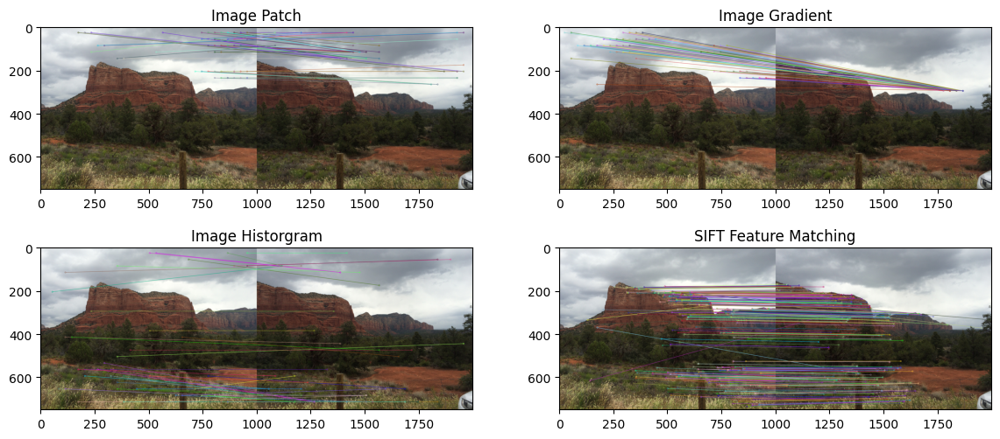

In [53]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(2, 2, 1)
plt.imshow(draw_image_patch_sedona_01)
plt.title('Image Patch')


# 원본 이미지 출력
plt.subplot(2, 2, 2)
plt.imshow(draw_image_grad_sedona_01)
plt.title('Image Gradient')

# 변경 적용 이미지
plt.subplot(2, 2, 3)
plt.imshow(draw_image_hist_sedona_01)
plt.title('Image Historgram')

plt.subplot(2, 2, 4)
plt.imshow(draw_image)
plt.title('SIFT Feature Matching')
plt.show()

- 결과 :
1. Image Patch : 매칭 선이 구름 위주로 형성되어 있습니다. 형성된 매칭 선의 기울기는 다양합니다.
2. Image Gradient : 오른쪽 사진 소수의 특징점과 왼쪽 사진의 다수의 특징점이 매칭이 되는 것이 관찰됩니다. 매칭 선이 거의 화살표처럼 뾰족합니다.
3. Image Histogram : 매칭선이 높이 기준으로 상, 중, 하 다양하게 형성됨을 확인했습니다.
4. SIFT Feature Matching : SIFT를 통해 앞서 Image Patch, Image Gradient, Image Histogram 보다 훨씬 정확한 매칭 선이 형성됨을 확인했습니다. 산을 중심으로 매칭선이 형성되었으며, 다수의 매칭 선이 수평에 가깝게 형성되었습니다. 소수의 부정확해 보이는 매칭선도 관찰됩니다.

### [문제 2. Homography and Stitching (30 pts)]

#### 2-1. Homography 행렬 H를 1-4에서 feature matching을 통해 얻어진 매칭 포인트들을 이용해 구해보세요. 이 때, cv2.findHomography 함수를 이용하고 method 값은 0(SVD 혹은 least-square 방식의 일반적 해법)으로 두어 모든 포인트들을 사용 하세요.

##### Annapruna

- 일반해법 기준 행렬 H 계산

In [54]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts = np.float32([keypoints_right_annapruna[m[0].trainIdx].pt for m in good_matches_annapruna]).reshape(-1, 1, 2)
dst_pts = np.float32([keypoints_left_annapruna[m[0].queryIdx].pt for m in good_matches_annapruna]).reshape(-1, 1, 2)
H_general_annapruna, _ = cv2.findHomography(src_pts, dst_pts, 0)

- 코드설명 :
1. src_pts에는 원본 이미지의 매칭된 키포인트 좌표가 저장됩니다.
2. [keypoints_right_annapruna[m[0].trainIdx].pt : good_matches_annapruna에 저장된 가장 좋은 매칭(m[0])의 학습 키포인트의 좌표를 나타냅니다.
3. dst_pts에는 대상 이미지의 매칭된 키포인트 좌표가 저장됩니다.
4. [keypoints_left_annapruna[m[0].queryIdx].pt : good_matches_annapruna에 저장된 가장 좋은 매칭(m[0])의 쿼리 키포인트의 좌표를 나타냅니다.
5. 위의 계산값을 float형으로 변환하고, reshape 함수를 적용하여 cv2.findHomography()함수의 입력 형식에 맞게 변경합니다. 해당 계산값을 src_pts, dst_pts에 저장합니다.
6. cv2.findHomography() 함수에 method = 0을 설정하여, 원본 이미지와 대상 이미지 간의 호모그래피 행렬을 일반 해법 방식으로 계산합니다

In [55]:
print("Homography 행렬:")
print(H_general_annapruna)

Homography 행렬:
[[-1.40926180e+00  5.40257592e-01  4.68520949e+02]
 [-1.20405083e+00  1.10003003e+00  1.31512422e+02]
 [-3.43058851e-03  1.22606701e-03  1.00000000e+00]]


##### bryce_01

- 일반해법 기준 행렬 H 계산

In [56]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts_bryce01 = np.float32([keypoints_right_bryce01[m[0].trainIdx].pt for m in good_matches_bryce01]).reshape(-1, 1, 2)
dst_pts_bryce01 = np.float32([keypoints_left_bryce01[m[0].queryIdx].pt for m in good_matches_bryce01]).reshape(-1, 1, 2)
H_general_bryce01, _ = cv2.findHomography(src_pts_bryce01, dst_pts_bryce01, 0)

print("Homography 행렬:")
print(H_general_bryce01)

Homography 행렬:
[[ 8.26524135e-01 -3.65491754e-03  3.11969809e+02]
 [ 1.10459462e-02  8.90405873e-01  2.90858554e+01]
 [-1.12458073e-04 -5.25543359e-05  1.00000000e+00]]


##### bryce_02

- 일반해법 기준 행렬 H 계산

In [57]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts_bryce02 = np.float32([keypoints_right_bryce02[m[0].trainIdx].pt for m in good_matches_bryce02]).reshape(-1, 1, 2)
dst_pts_bryce02 = np.float32([keypoints_left_bryce02[m[0].queryIdx].pt for m in good_matches_bryce02]).reshape(-1, 1, 2)
H_general_bryce02, _ = cv2.findHomography(src_pts_bryce02, dst_pts_bryce02, 0)

print("Homography 행렬:")
print(H_general_bryce02)

Homography 행렬:
[[ 1.53928735e+00 -1.34612041e-02  6.12685996e+02]
 [ 3.38414170e-01  1.05433701e+00 -2.83961245e+01]
 [ 6.26689710e-04 -4.30215852e-05  1.00000000e+00]]


##### bryce_03

- 일반해법 기준 행렬 H 계산

In [58]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts = np.float32([keypoints_right_bryce03[m[0].trainIdx].pt for m in good_matches_bryce03]).reshape(-1, 1, 2)
dst_pts = np.float32([keypoints_left_bryce03[m[0].queryIdx].pt for m in good_matches_bryce03]).reshape(-1, 1, 2)
H_general_bryce03, _ = cv2.findHomography(src_pts, dst_pts, 0)

print("Homography 행렬:")
print(H_general_bryce03)

Homography 행렬:
[[ 1.45165914e+00  8.00408844e-02  4.21719661e+02]
 [ 3.74135369e-01  1.20584902e+00 -1.54444356e+02]
 [ 5.50204389e-04  8.30393057e-05  1.00000000e+00]]


##### grand_canyon_01

- 일반해법 기준 행렬 H 계산

In [59]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts = np.float32([keypoints_right_grandcanyon01[m[0].trainIdx].pt for m in good_matches_grandcanyon01]).reshape(-1, 1, 2)
dst_pts = np.float32([keypoints_left_grandcanyon01[m[0].queryIdx].pt for m in good_matches_grandcanyon01]).reshape(-1, 1, 2)
H_general_grandcanyon01, _ = cv2.findHomography(src_pts, dst_pts, 0)

print("Homography 행렬:")
print(H_general_grandcanyon01)

Homography 행렬:
[[ 7.53918789e-01 -9.56537811e-02  2.98736486e+02]
 [-6.48715128e-03  7.55347871e-01  1.02815451e+01]
 [-1.49057559e-04 -1.78879185e-04  1.00000000e+00]]


##### grand_canyon_02

- 일반해법 기준 행렬 H 계산

In [60]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts = np.float32([keypoints_right_grandcanyon02[m[0].trainIdx].pt for m in good_matches_grandcanyon02]).reshape(-1, 1, 2)
dst_pts = np.float32([keypoints_left_grandcanyon02[m[0].queryIdx].pt for m in good_matches_grandcanyon02]).reshape(-1, 1, 2)
H_general_grandcanyon02, _ = cv2.findHomography(src_pts, dst_pts, 0)

print("Homography 행렬:")
print(H_general_grandcanyon02)

Homography 행렬:
[[ 1.11969472e+00 -1.60722837e-02  3.33305387e+02]
 [ 2.13290204e-01  1.11584670e+00 -5.97884378e+01]
 [ 1.86588809e-04  1.46500858e-04  1.00000000e+00]]


##### Scottsdale

- 일반해법 기준 행렬 H 계산

In [61]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts = np.float32([keypoints_right_scottsdale[m[0].trainIdx].pt for m in good_matches_scottsdale]).reshape(-1, 1, 2)
dst_pts = np.float32([keypoints_left_scottsdale[m[0].queryIdx].pt for m in good_matches_scottsdale]).reshape(-1, 1, 2)
H_general_scottsdale, _ = cv2.findHomography(src_pts, dst_pts, 0)

print("Homography 행렬:")
print(H_general_scottsdale)

Homography 행렬:
[[-9.66024353e-01  9.81919781e-02  6.96759222e+02]
 [-4.97262109e-01  4.40495131e-01  2.11755680e+02]
 [-1.37825720e-03  5.21747613e-06  1.00000000e+00]]


##### Sedona

- 일반해법 기준 행렬 H 계산

In [62]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts = np.float32([keypoints_right_sedona[m[0].trainIdx].pt for m in good_matches_sedona]).reshape(-1, 1, 2)
dst_pts = np.float32([keypoints_left_sedona[m[0].queryIdx].pt for m in good_matches_sedona]).reshape(-1, 1, 2)
H_general_sedona, _ = cv2.findHomography(src_pts, dst_pts, 0)

print("Homography 행렬:")
print(H_general_sedona)

Homography 행렬:
[[ 8.87245130e-01 -2.43231986e-01  3.22512386e+02]
 [ 1.40210462e-01  5.83704913e-01  4.63771431e+01]
 [ 2.97866427e-04 -5.69893439e-04  1.00000000e+00]]


#### 2-2. Homography 행렬 H를 RANSAC을 사용해 구해보세요. 마찬가지로, cv2.findHomography 함수를 이용하세요.

- RANSAC기준 행렬 H 계산

In [63]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts_annapruna = np.float32([keypoints_right_annapruna[m[0].trainIdx].pt for m in good_matches_annapruna]).reshape(-1, 1, 2)
dst_pts_annapruna = np.float32([keypoints_left_annapruna[m[0].queryIdx].pt for m in good_matches_annapruna]).reshape(-1, 1, 2)

# Homography 계산
H_RANSAC_annapruna, _ = cv2.findHomography(src_pts_annapruna, dst_pts_annapruna, cv2.RANSAC)

- 코드설명 :
1. src_pts에는 원본 이미지의 매칭된 키포인트 좌표가 저장됩니다.
2. [keypoints_right_annapruna[m[0].trainIdx].pt : good_matches_annapruna에 저장된 가장 좋은 매칭(m[0])의 학습 키포인트의 좌표를 나타냅니다.
3. dst_pts에는 대상 이미지의 매칭된 키포인트 좌표가 저장됩니다.
4. [keypoints_left_annapruna[m[0].queryIdx].pt : good_matches_annapruna에 저장된 가장 좋은 매칭(m[0])의 쿼리 키포인트의 좌표를 나타냅니다.
5. 위의 계산값을 float형으로 변환하고, reshape 함수를 적용하여 cv2.findHomography()함수의 입력 형식에 맞게 변경합니다. 해당 계산값을 src_pts, dst_pts에 저장합니다.
6. cv2.findHomography() 함수에 method = cv2.RANSAC을 설정하여, 원본 이미지와 대상 이미지 간의 호모그래피 행렬을 RANSAC 방식으로 계산합니다

In [64]:
print("Homography 행렬:")
print(H_RANSAC_annapruna)

Homography 행렬:
[[ 5.96747448e-01  1.46585199e-01  3.25120753e+02]
 [-2.84758707e-01  8.74273006e-01  6.36887453e+01]
 [-5.83470354e-04 -6.20301469e-05  1.00000000e+00]]


##### bryce_01

- RANSAC기준 행렬 H 계산

In [65]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts_bryce01 = np.float32([keypoints_right_bryce01[m[0].trainIdx].pt for m in good_matches_bryce01]).reshape(-1, 1, 2)
dst_pts_bryce01 = np.float32([keypoints_left_bryce01[m[0].queryIdx].pt for m in good_matches_bryce01]).reshape(-1, 1, 2)
H_RANSAC_bryce01, _ = cv2.findHomography(src_pts_bryce01, dst_pts_bryce01, cv2.RANSAC)

print("Homography 행렬:")
print(H_RANSAC_bryce01)

Homography 행렬:
[[ 6.34939042e-01  1.96111447e-02  3.28538372e+02]
 [-1.35841109e-01  8.95195760e-01  5.02913559e+01]
 [-3.80267061e-04  2.66831498e-05  1.00000000e+00]]


##### bryce_02

- RANSAC기준 행렬 H 계산

In [66]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts_bryce02 = np.float32([keypoints_right_bryce02[m[0].trainIdx].pt for m in good_matches_bryce02]).reshape(-1, 1, 2)
dst_pts_bryce02 = np.float32([keypoints_left_bryce02[m[0].queryIdx].pt for m in good_matches_bryce02]).reshape(-1, 1, 2)
H_RANSAC_bryce02, _ = cv2.findHomography(src_pts_bryce02, dst_pts_bryce02, cv2.RANSAC)

print("Homography 행렬:")
print(H_RANSAC_bryce02)

Homography 행렬:
[[ 8.39302798e-01 -1.48031884e-02  6.39071935e+02]
 [-4.79512860e-02  9.71129590e-01  2.23719754e+01]
 [-1.61923276e-04  7.41271230e-07  1.00000000e+00]]


##### bryce_03

- RANSAC기준 행렬 H 계산

In [67]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts_bryce03 = np.float32([keypoints_right_bryce03[m[0].trainIdx].pt for m in good_matches_bryce03]).reshape(-1, 1, 2)
dst_pts_bryce03 = np.float32([keypoints_left_bryce03[m[0].queryIdx].pt for m in good_matches_bryce03]).reshape(-1, 1, 2)
H_RANSAC_bryce03, _ = cv2.findHomography(src_pts_bryce03, dst_pts_bryce03, cv2.RANSAC)

print("Homography 행렬:")
print(H_RANSAC_bryce03)

Homography 행렬:
[[ 4.91275771e-01  8.76270350e-03  4.86341364e+02]
 [-1.54846875e-01  8.90578788e-01  4.16766783e-01]
 [-5.34389030e-04  5.18368899e-05  1.00000000e+00]]


##### grand_canyon_01

- RANSAC기준 행렬 H 계산

In [68]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts_grandcanyon01 = np.float32([keypoints_right_grandcanyon01[m[0].trainIdx].pt for m in good_matches_grandcanyon01]).reshape(-1, 1, 2)
dst_pts_grandcanyon01 = np.float32([keypoints_left_grandcanyon01[m[0].queryIdx].pt for m in good_matches_grandcanyon01]).reshape(-1, 1, 2)
H_RANSAC_grandcanyon01, _ = cv2.findHomography(src_pts_grandcanyon01, dst_pts_grandcanyon01, cv2.RANSAC)

print("Homography 행렬:")
print(H_RANSAC_grandcanyon01)

Homography 행렬:
[[ 7.23743746e-01  2.68326744e-03  2.93184178e+02]
 [-6.71859481e-02  9.28062709e-01 -1.92672809e+01]
 [-2.87416910e-04  5.55720242e-05  1.00000000e+00]]


##### grand_canyon_02

- RANSAC기준 행렬 H 계산

In [69]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts_grandcanyon02 = np.float32([keypoints_right_grandcanyon02[m[0].trainIdx].pt for m in good_matches_grandcanyon02]).reshape(-1, 1, 2)
dst_pts_grandcanyon02 = np.float32([keypoints_left_grandcanyon02[m[0].queryIdx].pt for m in good_matches_grandcanyon02]).reshape(-1, 1, 2)
H_RANSAC_grandcanyon02, _ = cv2.findHomography(src_pts_grandcanyon02, dst_pts_grandcanyon02, cv2.RANSAC)

print("Homography 행렬:")
print(H_RANSAC_grandcanyon02)

Homography 행렬:
[[ 6.68834337e-01 -5.00369825e-02  3.45588773e+02]
 [-6.43666943e-02  8.88210404e-01  2.40662684e+01]
 [-3.25303474e-04  1.23044086e-05  1.00000000e+00]]


##### Scottsdale

- RANSAC기준 행렬 H 계산

In [70]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts_scottsdale = np.float32([keypoints_right_scottsdale[m[0].trainIdx].pt for m in good_matches_scottsdale]).reshape(-1, 1, 2)
dst_pts_scottsdale = np.float32([keypoints_left_scottsdale[m[0].queryIdx].pt for m in good_matches_scottsdale]).reshape(-1, 1, 2)
H_RANSAC_scottsdale, _ = cv2.findHomography(src_pts_scottsdale, dst_pts_scottsdale, cv2.RANSAC)

print("Homography 행렬:")
print(H_RANSAC_scottsdale)

Homography 행렬:
[[ 3.94577345e-01 -9.03277215e-03  5.57167573e+02]
 [-2.30616852e-01  8.29401908e-01  7.88949598e+01]
 [-5.79483867e-04 -5.72066925e-05  1.00000000e+00]]


##### Sedona

- RANSAC기준 행렬 H 계산

In [71]:
# 좋은 매칭점의 소스와 목적지 키포인트 추출
src_pts_sedona = np.float32([keypoints_right_sedona[m[0].trainIdx].pt for m in good_matches_sedona]).reshape(-1, 1, 2)
dst_pts_sedona = np.float32([keypoints_left_sedona[m[0].queryIdx].pt for m in good_matches_sedona]).reshape(-1, 1, 2)
H_RANSAC_sedona, _ = cv2.findHomography(src_pts_sedona, dst_pts_sedona, cv2.RANSAC)

print("Homography 행렬:")
print(H_RANSAC_sedona)

Homography 행렬:
[[ 6.61476444e-01  1.98421029e-02  3.02131508e+02]
 [-1.33391526e-01  8.81992324e-01  3.64446114e+01]
 [-3.45561836e-04  7.15912603e-06  1.00000000e+00]]


#### 2-3. 앞서 2-1과 2-2에서 구한 두 가지의 Homography 행렬을 이용해, “paired images” 폴더에 있는 이미지들로 각각 image stitching을 해보고 잘 되는 이미지들과 잘 안되는 이미지들을 분석해보세요(image stitching이 잘 되는 경우가 없으면 감점). 이 때, cv2.warpPerspective 함수를 사용하세요. 2-1과 2-2의 결과를 보이고, 차이에 대한 분석을 서술하세요.

##### Annapruna

- 이미지 스티칭 (general 방식)

In [72]:
# 이미지 스티칭 (general 방식)
stitched_general_annapruna = cv2.warpPerspective(image_right_annapruna, H_general_annapruna, (image_right_annapruna.shape[1] + image_left_annapruna.shape[1], image_right_annapruna.shape[0]))
stitched_general_annapruna[0 : image_right_annapruna.shape[0], 0:image_left_annapruna.shape[1]] = image_left_annapruna

# 이미지 스티칭 (RANSAC 방식)
stitched_ransac_annapruna = cv2.warpPerspective(image_right_annapruna, H_RANSAC_annapruna, (image_right_annapruna.shape[1] + image_left_annapruna.shape[1], image_right_annapruna.shape[0]))
stitched_ransac_annapruna[0 : image_right_annapruna.shape[0], 0:image_left_annapruna.shape[1]] = image_left_annapruna

- 코드 설명 :
1. 이미지 스티칭을 수행하기 위해 cv2.warpPerspective(변환할 이미지,Homography 행렬, (이미지 너비, 이미지 높이)) 함수를 활용합니다.
2. 오른쪽 이미지에 Homography 행렬을 적용해 스티칭을 수행합니다.
3. 오른쪽 이미지의 너비와 왼쪽 이미지의 너비를 합한 값으로 변환 이미지의 너비를 설정하고, 오른쪽 이미지의 높이 값으로 변환 이미지의 높이를 설정합니다. 해당 스티칭된 이미지를 스티칭 객체에 저장합니다.
4. 스티칭 객체 이미지의 왼쪽(오른쪽 이미지와 겹치는 부분)에 원본 왼쪽 이미지를 삽입합니다. 이를 통해, 이미지를 자연스럽게 스티칭합니다.

- 이미지 출력

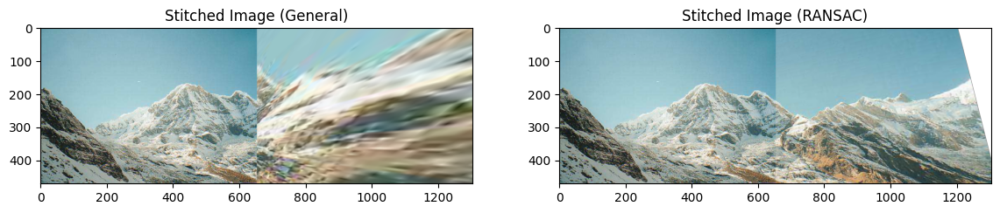

In [73]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_general_annapruna)
plt.title('Stitched Image (General)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(stitched_ransac_annapruna)
plt.title('Stitched Image (RANSAC)')
plt.show()

- 결과분석 :
1. general 방식으로 스티칭을 수행한 경우, 성능이 좋지 않습니다.
   매칭 포인트의 이상치가 많아, 성능이 좋지 않은 것으로 판단됩니다. 눈 쌓인 산의 모습이 비슷해 보이기 때문에 이상치가 많이 발생한 것으로 판단됩니다.
2. RANSAC 방식으로 스티칭을 수행한 경우가 성능이 좋고 자연스럽습니다.
   매칭 포인트의 이상치가 고려되어, 좋은 성능을 보이는 것으로 판단됩니다.

##### bryce_01

- 이미지 스티칭

In [74]:
# 이미지 스티칭 (general 방식)
stitched_general_bryce01 = cv2.warpPerspective(image_right_bryce01, H_general_bryce01, (image_right_bryce01.shape[1] + image_left_bryce01.shape[1], image_right_bryce01.shape[0]))
stitched_general_bryce01[0 : image_right_bryce01.shape[0], 0:image_left_bryce01.shape[1]] = image_left_bryce01

# 이미지 스티칭 (RANSAC 방식)
stitched_ransac_bryce01 = cv2.warpPerspective(image_right_bryce01, H_RANSAC_bryce01, (image_right_bryce01.shape[1] + image_left_bryce01.shape[1], image_right_bryce01.shape[0]))
stitched_ransac_bryce01[0 : image_right_bryce01.shape[0], 0:image_left_bryce01.shape[1]] = image_left_bryce01

- 이미지 출력

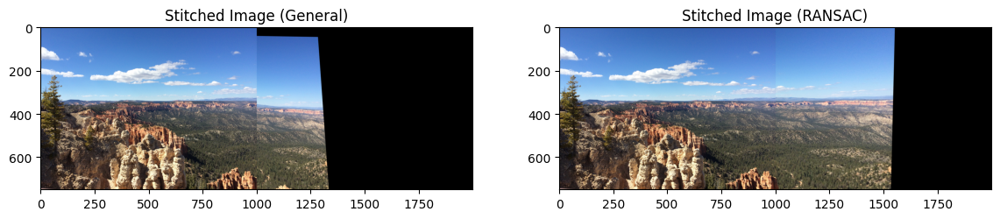

In [75]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_general_bryce01)
plt.title('Stitched Image (General)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(stitched_ransac_bryce01)
plt.title('Stitched Image (RANSAC)')
plt.show()

- 결과분석 :
1. general 방식으로 스티칭을 수행한 경우, 이미시 스티칭이 부정확하게 수행되었습니다. 매칭 포인트의 이상치로 인해 성능이 좋지 않은 것으로 판단됩니다. 양쪽 이미지의 수평선과 하늘의 경계가 불분명해서 이상치가 다수 발생한 것으로 예상됩니다.
2. RANSAC 방식으로 스티칭을 수행한 경우가 성능이 좋고 자연스럽습니다.
   매칭 포인트의 이상치가 고려되어, 좋은 성능을 보이는 것으로 판단됩니다.

##### bryce_02

- 이미지 스티칭

In [76]:
# 이미지 스티칭 (general 방식)
stitched_general_bryce02 = cv2.warpPerspective(image_right_bryce02, H_general_bryce02, (image_right_bryce02.shape[1] + image_left_bryce02.shape[1], image_right_bryce02.shape[0]))
stitched_general_bryce02[0 : image_right_bryce02.shape[0], 0:image_left_bryce02.shape[1]] = image_left_bryce02

# 이미지 스티칭 (RANSAC 방식)
stitched_ransac_bryce02 = cv2.warpPerspective(image_right_bryce02, H_RANSAC_bryce02, (image_right_bryce02.shape[1] + image_left_bryce02.shape[1], image_right_bryce02.shape[0]))
stitched_ransac_bryce02[0 : image_right_bryce02.shape[0], 0:image_left_bryce02.shape[1]] = image_left_bryce02

- 이미지 출력

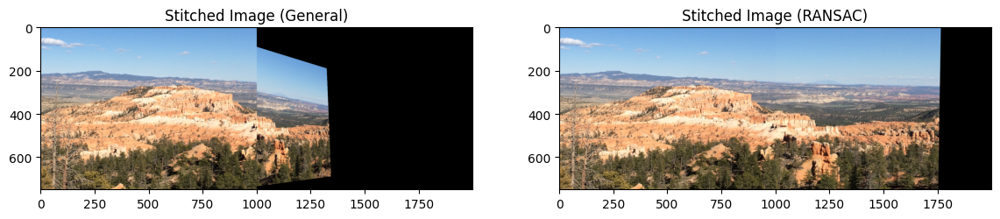

In [77]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_general_bryce02)
plt.title('Stitched Image (General)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(stitched_ransac_bryce02)
plt.title('Stitched Image (RANSAC)')
plt.show()

- 결과분석 :
1. general 방식으로 스티칭을 수행한 경우, 이미지 스티칭이 부정확하게 수행되었습니다. 멀리 있는 산과 하늘의 경계 부근에서 약간의 뎁스 차이로 인해 이상치가 발생한 것으로 예상됩니다.
2. RANSAC 방식으로 스티칭을 수행한 경우가 성능이 좋고 자연스럽습니다.
   매칭 포인트의 이상치가 고려되어, 좋은 성능을 보이는 것으로 판단됩니다.

##### bryce_03

- 이미지 스티칭

In [78]:
# 이미지 스티칭 (general 방식)
stitched_general_bryce03 = cv2.warpPerspective(image_right_bryce03, H_general_bryce03, (image_right_bryce03.shape[1] + image_left_bryce03.shape[1], image_right_bryce03.shape[0]))
stitched_general_bryce03[0 : image_right_bryce03.shape[0], 0:image_left_bryce03.shape[1]] = image_left_bryce03

# 이미지 스티칭 (RANSAC 방식)
stitched_ransac_bryce03 = cv2.warpPerspective(image_right_bryce03, H_RANSAC_bryce03, (image_right_bryce03.shape[1] + image_left_bryce03.shape[1], image_right_bryce03.shape[0]))
stitched_ransac_bryce03[0 : image_right_bryce03.shape[0], 0:image_left_bryce03.shape[1]] = image_left_bryce03

- 이미지 출력

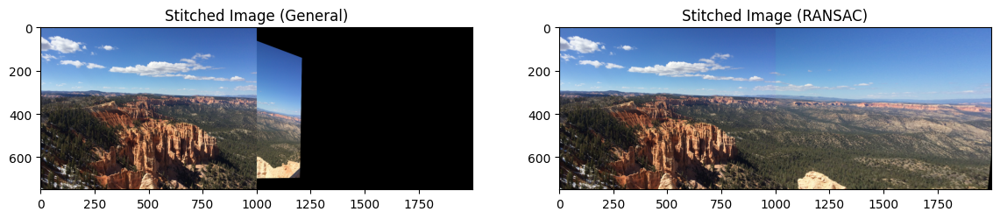

In [79]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_general_bryce03)
plt.title('Stitched Image (General)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(stitched_ransac_bryce03)
plt.title('Stitched Image (RANSAC)')
plt.show()

- 결과분석 :
1. general 방식으로 스티칭을 수행한 경우, 성능이 좋지 않습니다. 이미지의 하늘과 바다의 경계를 구분하지 못해서, 약간의 뎁스 차이가 있어서 이상치가 다수 발생한 것으로 예상됩니다.
2. RANSAC 방식으로 스티칭을 수행한 경우가 성능이 좋고 자연스럽습니다.
   매칭 포인트의 이상치가 고려되어, 좋은 성능을 보이는 것으로 판단됩니다.

##### grand_canyon_01

- 이미지 스티칭

In [80]:
# 이미지 스티칭 (general 방식)
stitched_general_grandcanyon01 = cv2.warpPerspective(image_right_grandcanyon01, H_general_grandcanyon01, (image_right_grandcanyon01.shape[1] + image_left_grandcanyon01.shape[1], image_right_grandcanyon01.shape[0]))
stitched_general_grandcanyon01[0 : image_right_grandcanyon01.shape[0], 0:image_left_grandcanyon01.shape[1]] = image_left_grandcanyon01

# 이미지 스티칭 (RANSAC 방식)
stitched_ransac_grandcanyon01 = cv2.warpPerspective(image_right_grandcanyon01, H_RANSAC_grandcanyon01, (image_right_grandcanyon01.shape[1] + image_left_grandcanyon01.shape[1], image_right_grandcanyon01.shape[0]))
stitched_ransac_grandcanyon01[0 : image_right_grandcanyon01.shape[0], 0:image_left_grandcanyon01.shape[1]] = image_left_grandcanyon01

- 이미지 출력

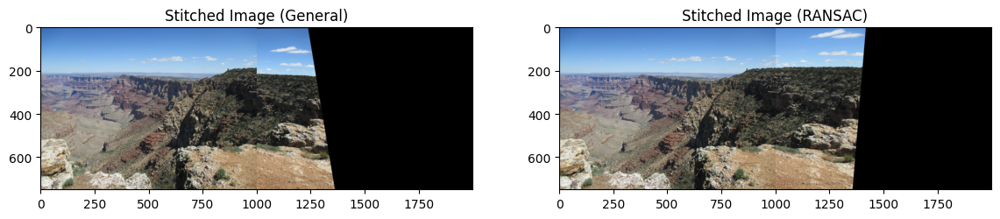

In [81]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_general_grandcanyon01)
plt.title('Stitched Image (General)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(stitched_ransac_grandcanyon01)
plt.title('Stitched Image (RANSAC)')
plt.show()

- 결과분석 :
1. general 방식으로 스티칭을 수행한 경우, RANSAC 만큼 성능이 좋지 않습니다. 다만, 다른 이미지에 general 방식을 적용한 경우와 비교했을 때, 성능이 좋은 편에 속합니다. 경계 부근의 작은 구름으로 인해 이상치가 발생한 것으로 예상됩니다.
2. RANSAC 방식으로 스티칭을 수행한 경우가 성능이 좋고 자연스럽습니다.
   매칭 포인트의 이상치가 충분히 고려되어, 좋은 성능을 보이는 것으로 판단됩니다.

#### grand_canyon_02

- 이미지 스티칭

In [82]:
# 이미지 스티칭 (general 방식)
stitched_general_grandcanyon02 = cv2.warpPerspective(image_right_grandcanyon02, H_general_grandcanyon02, (image_right_grandcanyon02.shape[1] + image_left_grandcanyon02.shape[1], image_right_grandcanyon02.shape[0]))
stitched_general_grandcanyon02[0 : image_right_grandcanyon02.shape[0], 0:image_left_grandcanyon02.shape[1]] = image_left_grandcanyon02

# 이미지 스티칭 (RANSAC 방식)
stitched_ransac_grandcanyon02 = cv2.warpPerspective(image_right_grandcanyon02, H_RANSAC_grandcanyon02, (image_right_grandcanyon02.shape[1] + image_left_grandcanyon02.shape[1], image_right_grandcanyon02.shape[0]))
stitched_ransac_grandcanyon02[0 : image_right_grandcanyon02.shape[0], 0:image_left_grandcanyon02.shape[1]] = image_left_grandcanyon02

- 이미지 출력

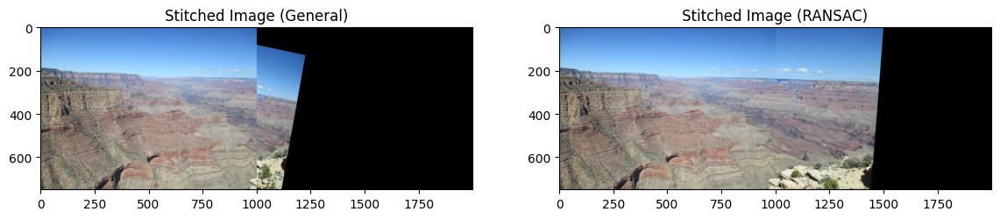

In [83]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_general_grandcanyon02)
plt.title('Stitched Image (General)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(stitched_ransac_grandcanyon02)
plt.title('Stitched Image (RANSAC)')
plt.show()

- 결과분석 :
1. general 방식으로 스티칭을 수행한 경우, 성능이 좋지 않습니다. 그랜드 캐니언의 다양한 협곡구조로 인해 다수의 이상치가 발생한 것으로 예상됩니다.
2. RANSAC 방식으로 스티칭을 수행한 경우가 성능이 좋고 자연스럽습니다.
   매칭 포인트의 이상치가 충분히 고려되어, 좋은 성능을 보이는 것으로 판단됩니다.

#### scottsdale

- 이미지 스티칭

In [84]:
# 이미지 스티칭 (general 방식)
stitched_general_scottsdale = cv2.warpPerspective(image_right_scottsdale_right_01, H_general_scottsdale, (image_right_scottsdale_right_01.shape[1] + image_left_scottsdale_left_01.shape[1], image_right_scottsdale_right_01.shape[0]))
stitched_general_scottsdale[0 : image_right_scottsdale_right_01.shape[0], 0:image_left_scottsdale_left_01.shape[1]] = image_left_scottsdale_left_01

# 이미지 스티칭 (RANSAC 방식)
stitched_ransac_scottsdale = cv2.warpPerspective(image_right_scottsdale_right_01, H_RANSAC_scottsdale, (image_right_scottsdale_right_01.shape[1] + image_left_scottsdale_left_01.shape[1], image_right_scottsdale_right_01.shape[0]))
stitched_ransac_scottsdale[0 : image_right_scottsdale_right_01.shape[0], 0:image_left_scottsdale_left_01.shape[1]] = image_left_scottsdale_left_01

- 이미지 출력

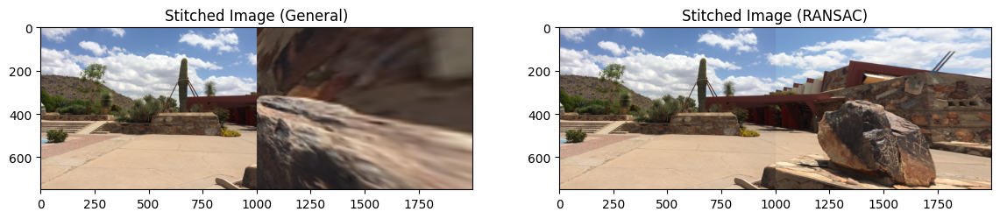

In [85]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_general_scottsdale)
plt.title('Stitched Image (General)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(stitched_ransac_scottsdale)
plt.title('Stitched Image (RANSAC)')
plt.show()

- 결과분석 :
1. general 방식으로 스티칭을 수행한 경우, 성능이 매우 좋지 않습니다. 이미지의 뎁스 차이가 크기 때문에 매우 많은 이상치가 발생한 것으로 예상됩니다.
2. RANSAC 방식으로 스티칭을 수행한 경우 이미지가 자연스럽게 이어졌습니다.
   매칭 포인트의 이상치가 충분히 고려되어 자연스럽게 이어진 것으로 판단됩니다.

#### sedona

- 이미지 스티칭

In [86]:
# 이미지 스티칭 (general 방식)
stitched_general_sedona = cv2.warpPerspective(image_right_sedona_right_01, H_general_sedona, (image_right_sedona_right_01.shape[1] + image_left_sedona_left_01.shape[1], image_right_sedona_right_01.shape[0]))
stitched_general_sedona[0 : image_right_sedona_right_01.shape[0], 0:image_left_sedona_left_01.shape[1]] = image_left_sedona_left_01

# 이미지 스티칭 (RANSAC 방식)
stitched_ransac_sedona = cv2.warpPerspective(image_right_sedona_right_01, H_RANSAC_sedona, (image_right_sedona_right_01.shape[1] + image_left_sedona_left_01.shape[1], image_right_sedona_right_01.shape[0]))
stitched_ransac_sedona[0 : image_right_sedona_right_01.shape[0], 0:image_left_sedona_left_01.shape[1]] = image_left_sedona_left_01

- 이미지 출력

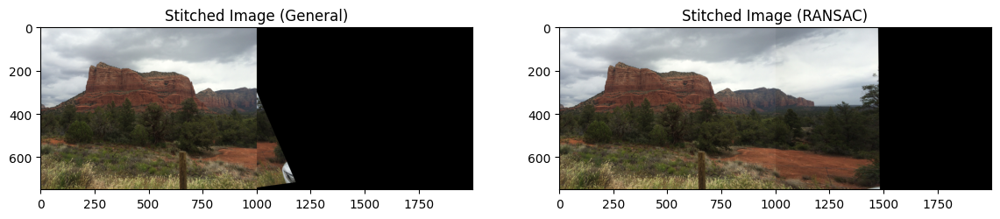

In [87]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_general_sedona)
plt.title('Stitched Image (General)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(stitched_ransac_sedona)
plt.title('Stitched Image (RANSAC)')
plt.show()

- 결과분석 :
1. general 방식으로 스티칭을 수행한 경우, 성능이 좋지 않습니다. 왼쪽 이미지와 오른쪽 이미지의 뎁스 차이가 있어서 다수의 이상치가 발생한 것으로 예상됩니다.
2. RANSAC 방식으로 스티칭을 수행한 경우 이미지가 자연스럽게 이어졌습니다.
   매칭 포인트의 이상치가 충분히 고려되어 자연스럽게 이어진 것으로 판단됩니다.

### [문제 3. Homography with RANSAC 직접 구현 (40 pts)]

#### 3-1. RANSAC 알고리즘을 통한 Homography 행렬 H를 구하는 함수를 직접 구현해 구해보세요. 이 때, cv2.findHomography와 같이 H를 직접적으로 구해주는 Library를 사용하지 마세요. 다만, Numpy와 같이 중간 결과를 편하게 계산해주는 Library 사용은 가능합니다.

In [88]:
import numpy as np

def calculate_homography(src_pts, dst_pts):
    A = []
    for src, dst in zip(src_pts, dst_pts):
        x, y = src
        u, v = dst
        A.append([-x, -y, -1, 0, 0, 0, x*u, y*u, u])
        A.append([0, 0, 0, -x, -y, -1, x*v, y*v, v])
    A = np.asarray(A)
    U, S, V = np.linalg.svd(A)
    H = V[-1].reshape(3, 3)
    H /= H[2, 2]
    return H

- 코드 설명 :
1. 입력으로 들어온 src_pts와 dst_pts에서 키포인트 좌표 쌍을 이용하여 호모그래피 행렬을 계산합니다.
2. 비어있는 리스트 A를 생성합니다.
3. for 루프를 사용하여 src_pts와 dst_pts의 각 키포인트 좌표 쌍을 순회합니다.
4. 각 포인트 쌍에서, 원본 좌표(src)와 대상 좌표(dst)를 각각 (x, y)와 (u, v)로 할당합니다.
5. A에는 포인트 쌍을 이용하여 계산한 행렬 값들을 추가합니다. 이 행렬 값은 호모그래피 행렬을 계산하는 데 사용됩니다.
6. 리스트 A를 NumPy 배열로 변환합니다.
7. A 행렬에 대해 SVD(Singular Value Decomposition)를 수행하여 U, S, V 세 행렬을 얻습니다.
8. V 행렬에서 마지막 행을 추출하여 3x3 형태의 호모그래피 행렬을 구성합니다.
9. 호모그래피 행렬의 마지막 요소(H[2, 2])로 나누어 정규화합니다.
10. 계산된 호모그래피 행렬을 반환합니다.

In [89]:
def find_homography_ransac(src_pts, dst_pts, num_iterations=1000, inlier_threshold=5):
    best_H = None
    best_num_inliers = 0

    for _ in range(num_iterations):
        # 임의의 포인트 쌍을 선택하여 Homography 행렬 계산
        indices = np.random.choice(len(src_pts), 4, replace=False)
        src_sample = src_pts[indices]
        dst_sample = dst_pts[indices]
        H = calculate_homography(src_sample, dst_sample)

        # 모든 포인트에 대해 재투영하여 인라이어 찾기
        projected_dst = np.dot(H, np.vstack((src_pts.T, np.ones(len(src_pts)))))
        projected_dst = projected_dst[:2] / projected_dst[2]
        errors = np.linalg.norm(projected_dst - dst_pts.T, axis=0)
        inliers = np.where(errors < inlier_threshold)[0]

        # 현재 모델의 인라이어 수 계산
        num_inliers = len(inliers)

        # 현재 모델이 더 좋은지 확인하여 업데이트
        if num_inliers > best_num_inliers:
            best_H = H
            best_num_inliers = num_inliers

    return best_H

- 코드 설명 :
1. src_pts와 dst_pts로 주어진 키포인트 좌표 쌍을 이용하여 호모그래피 행렬을 추정합니다.
2. num_iterations 매개변수는 RANSAC 알고리즘이 반복되는 횟수를 결정합니다. 기본값은 1000입니다.
3. inlier_threshold 매개변수는 인라이어로 판단되는 에러의 임계값을 결정합니다. 기본값은 5입니다.
4. best_H 변수는 현재까지 찾은 가장 좋은 호모그래피 행렬을 저장합니다. 초기값은 None 입니다.
5. best_num_inliers 변수는 현재까지 찾은 가장 많은 인라이어의 수를 저장합니다. 초기값은 0 입니다.
6. num_iterations만큼 반복하는 반복문을 구성했습니다. 반복문 안에서는 다음과 같은 과정이 수행됩니다.
7. 무작위로 키포인트 좌표쌍을 선택해서 호모그래피 행렬을 통해 소스 포인트를 목표 포인트로 재투영합니다. 이를 위해 소스 포인트를 열벡터로 변환하고, H와 행렬곱을 수행합니다.
8. 재투영된 포인트는 정규화 되어 있기 때문에, 이를 원래의 이미지 좌표계로 변환하기 위해 x, y 좌표를 3번째 행(정규화된 좌표)로 나누어줍니다.
9. np.linalg.norm 함수를 사용해서 재투영된 포인트와 목표 포인트 사이의 유클리드 거리를 계산합니다. 해당 값은 errors에 저장됩니다.
10. errors가 주어진 임계값보다 작은 포인트를 인라이어로 식별합니다. 이를 위해 np.where 함수를 사용해 errors가 임계값보다 작은 index를 찾습니다.
11. 현재 모델의 인라이어 수를 계산합니다.
12. 현재 모델이 이전 모델보다 더 나은지 확인하고, 더 나은 경우 가장 좋은 호모그래피 행렬을 best_H에, 인라이어 수를 best_num_inliers에 업데이트합니다.
13. 반복이 완료되면 가장 좋은 호모그래피 행렬을 반환합니다.

#### 3-2. 앞서 3-1에서 구한 두 가지의 Homography 행렬을 이용해, “paired images” 폴더에 있는 이미지들 여러 장으로 image stitching을 해보세요. 2-3과 동일하게, cv2.warpPerspective(…) 함수를 사용하세요. 해당 결과를 2-2 결과와 비교해 구현이 올바른지 검증해보세요.

##### Annapruna

- 직접구현한 함수를 활용해서 RANSAC 행렬 H 계산 및 적용

In [90]:
# RANSAC 알고리즘을 사용하여 Homography 행렬 계산
my_H_RANSAC_annapruna = find_homography_ransac(src_pts_annapruna.squeeze(), dst_pts_annapruna.squeeze())

# 이미지 스티칭 (RANSAC 방식)
my_stitched_ransac_annapruna = cv2.warpPerspective(image_right_annapruna, my_H_RANSAC_annapruna, (image_right_annapruna.shape[1] + image_left_annapruna.shape[1], image_right_annapruna.shape[0]))
my_stitched_ransac_annapruna[0 : image_right_annapruna.shape[0], 0:image_left_annapruna.shape[1]] = image_left_annapruna

- 이미지 출력

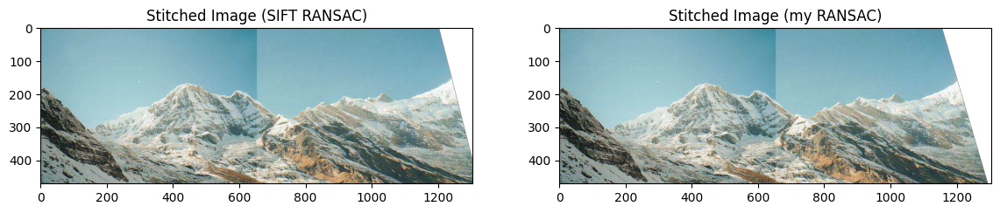

In [91]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_ransac_annapruna)
plt.title('Stitched Image (SIFT RANSAC)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(my_stitched_ransac_annapruna)
plt.title('Stitched Image (my RANSAC)')
plt.show()

- 결과 :
SIFT RANSAC와 my RANSAC의 결과가 매우 유사합니다.
직접 구현한 함수 find_homography_ransac가 올바르게 구현된 것으로 판단됩니다.

##### bryce_01

- 직접구현한 함수를 활용해서 RANSAC 행렬 H 계산 및 적용

In [92]:
# RANSAC 알고리즘을 사용하여 Homography 행렬 계산
my_H_RANSAC_bryce01 = find_homography_ransac(src_pts_bryce01.squeeze(), dst_pts_bryce01.squeeze())

# 이미지 스티칭 (RANSAC 방식)
my_stitched_ransac_bryce01 = cv2.warpPerspective(image_right_bryce01, my_H_RANSAC_bryce01, (image_right_bryce01.shape[1] + image_left_bryce01.shape[1], image_right_bryce01.shape[0]))
my_stitched_ransac_bryce01[0 : image_right_bryce01.shape[0], 0:image_left_bryce01.shape[1]] = image_left_bryce01

- 이미지 출력

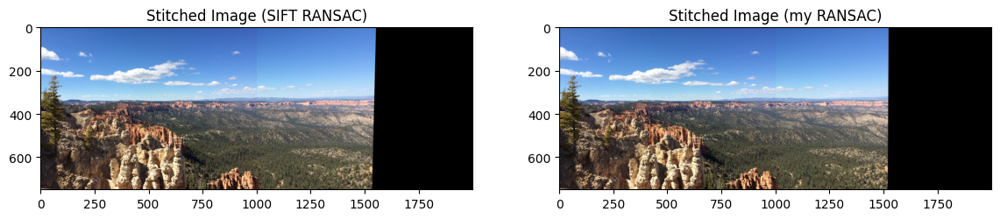

In [93]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_ransac_bryce01)
plt.title('Stitched Image (SIFT RANSAC)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(my_stitched_ransac_bryce01)
plt.title('Stitched Image (my RANSAC)')
plt.show()

- 결과 :
SIFT RANSAC와 my RANSAC의 결과가 매우 유사합니다.
직접 구현한 함수 find_homography_ransac가 올바르게 구현된 것으로 판단됩니다.

##### bryce_02

- 직접구현한 함수를 활용해서 RANSAC 행렬 H 계산 및 적용

In [94]:
# RANSAC 알고리즘을 사용하여 Homography 행렬 계산
my_H_RANSAC_bryce02 = find_homography_ransac(src_pts_bryce02.squeeze(), dst_pts_bryce02.squeeze())

# 이미지 스티칭 (RANSAC 방식)
my_stitched_ransac_bryce02 = cv2.warpPerspective(image_right_bryce02, my_H_RANSAC_bryce02, (image_right_bryce02.shape[1] + image_left_bryce02.shape[1], image_right_bryce02.shape[0]))
my_stitched_ransac_bryce02[0 : image_right_bryce02.shape[0], 0:image_left_bryce02.shape[1]] = image_left_bryce02

- 이미지 출력

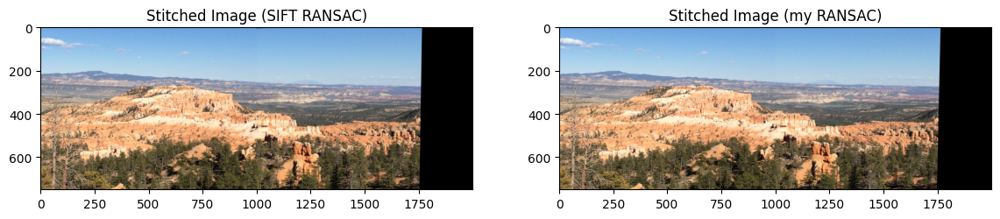

In [95]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_ransac_bryce02)
plt.title('Stitched Image (SIFT RANSAC)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(my_stitched_ransac_bryce02)
plt.title('Stitched Image (my RANSAC)')
plt.show()

- 결과 :
SIFT RANSAC와 my RANSAC의 결과가 매우 유사합니다.
직접 구현한 함수 find_homography_ransac가 올바르게 구현된 것으로 판단됩니다.

##### bryce_03

- 직접구현한 함수를 활용해서 RANSAC 행렬 H 계산 및 적용

In [96]:
# RANSAC 알고리즘을 사용하여 Homography 행렬 계산
my_H_RANSAC_bryce03 = find_homography_ransac(src_pts_bryce03.squeeze(), dst_pts_bryce03.squeeze())

# 이미지 스티칭 (RANSAC 방식)
my_stitched_ransac_bryce03 = cv2.warpPerspective(image_right_bryce03, my_H_RANSAC_bryce03, (image_right_bryce03.shape[1] + image_left_bryce03.shape[1], image_right_bryce03.shape[0]))
my_stitched_ransac_bryce03[0 : image_right_bryce03.shape[0], 0:image_left_bryce03.shape[1]] = image_left_bryce03

- 이미지 출력

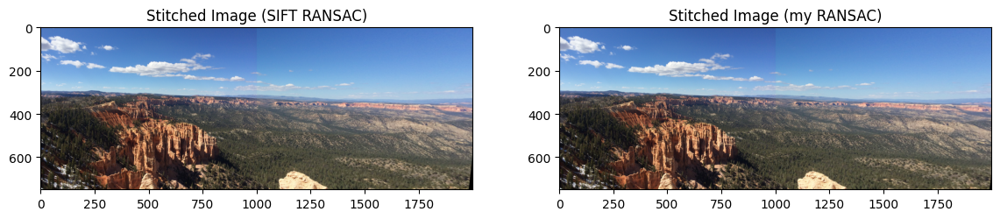

In [97]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_ransac_bryce03)
plt.title('Stitched Image (SIFT RANSAC)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(my_stitched_ransac_bryce03)
plt.title('Stitched Image (my RANSAC)')
plt.show()

- 결과 :
SIFT RANSAC와 my RANSAC의 결과가 매우 유사합니다.
직접 구현한 함수 find_homography_ransac가 올바르게 구현된 것으로 판단됩니다.

##### grand_canyon_01

- 직접구현한 함수를 활용해서 RANSAC 행렬 H 계산 및 적용

In [98]:
# RANSAC 알고리즘을 사용하여 Homography 행렬 계산
my_H_RANSAC_grandcanyon01 = find_homography_ransac(src_pts_grandcanyon01.squeeze(), dst_pts_grandcanyon01.squeeze())

# 이미지 스티칭 (RANSAC 방식)
my_stitched_ransac_grandcanyon01 = cv2.warpPerspective(image_right_grandcanyon01, my_H_RANSAC_grandcanyon01, (image_right_grandcanyon01.shape[1] + image_left_grandcanyon01.shape[1], image_right_grandcanyon01.shape[0]))
my_stitched_ransac_grandcanyon01[0 : image_right_grandcanyon01.shape[0], 0:image_left_grandcanyon01.shape[1]] = image_left_grandcanyon01

- 이미지 출력

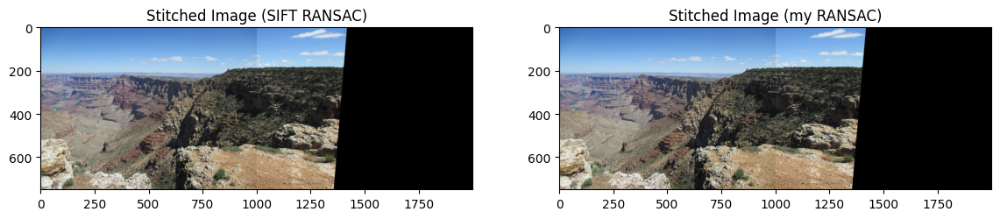

In [99]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_ransac_grandcanyon01)
plt.title('Stitched Image (SIFT RANSAC)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(my_stitched_ransac_grandcanyon01)
plt.title('Stitched Image (my RANSAC)')
plt.show()

- 결과 :
SIFT RANSAC와 my RANSAC의 결과가 매우 유사합니다.
직접 구현한 함수 find_homography_ransac가 올바르게 구현된 것으로 판단됩니다.

##### grand_canyon_02

- 직접구현한 함수를 활용해서 RANSAC 행렬 H 계산 및 적용

In [100]:
# RANSAC 알고리즘을 사용하여 Homography 행렬 계산
my_H_RANSAC_grandcanyon02 = find_homography_ransac(src_pts_grandcanyon02.squeeze(), dst_pts_grandcanyon02.squeeze())

# 이미지 스티칭 (RANSAC 방식)
my_stitched_ransac_grandcanyon02 = cv2.warpPerspective(image_right_grandcanyon02, my_H_RANSAC_grandcanyon02, (image_right_grandcanyon02.shape[1] + image_left_grandcanyon02.shape[1], image_right_grandcanyon02.shape[0]))
my_stitched_ransac_grandcanyon02[0 : image_right_grandcanyon02.shape[0], 0:image_left_grandcanyon02.shape[1]] = image_left_grandcanyon02

- 이미지 출력

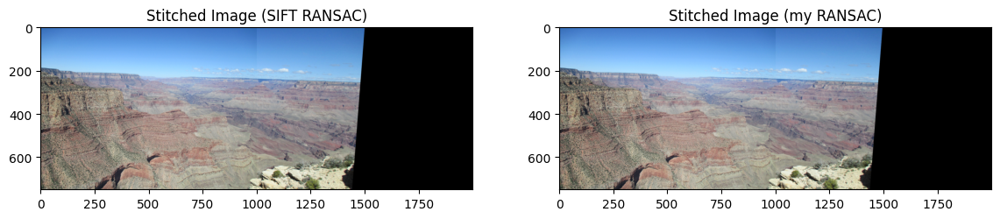

In [101]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_ransac_grandcanyon02)
plt.title('Stitched Image (SIFT RANSAC)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(my_stitched_ransac_grandcanyon02)
plt.title('Stitched Image (my RANSAC)')
plt.show()

- 결과 :
SIFT RANSAC와 my RANSAC의 결과가 매우 유사합니다.
직접 구현한 함수 find_homography_ransac가 올바르게 구현된 것으로 판단됩니다.

##### Scottsdale

- 직접구현한 함수를 활용해서 RANSAC 행렬 H 계산 및 적용

In [102]:
# RANSAC 알고리즘을 사용하여 Homography 행렬 계산
my_H_RANSAC_scottsdale = find_homography_ransac(src_pts_scottsdale.squeeze(), dst_pts_scottsdale.squeeze())

# 이미지 스티칭 (RANSAC 방식)
my_stitched_ransac_scottsdale = cv2.warpPerspective(image_right_scottsdale_right_01, my_H_RANSAC_scottsdale, (image_right_scottsdale_right_01.shape[1] + image_left_scottsdale_left_01.shape[1], image_right_scottsdale_right_01.shape[0]))
my_stitched_ransac_scottsdale[0 : image_right_scottsdale_right_01.shape[0], 0:image_left_scottsdale_left_01.shape[1]] = image_left_scottsdale_left_01

- 이미지 출력

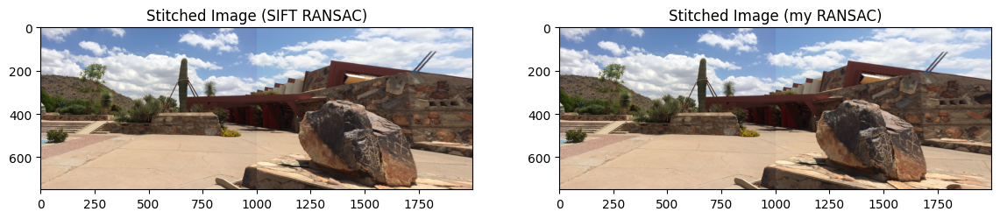

In [103]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_ransac_scottsdale)
plt.title('Stitched Image (SIFT RANSAC)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(my_stitched_ransac_scottsdale)
plt.title('Stitched Image (my RANSAC)')
plt.show()

- 결과 :
SIFT RANSAC와 my RANSAC의 결과가 매우 유사합니다.
직접 구현한 함수 find_homography_ransac가 올바르게 구현된 것으로 판단됩니다.

##### Sedona

- 직접구현한 함수를 활용해서 RANSAC 행렬 H 계산 및 적용

In [104]:
# RANSAC 알고리즘을 사용하여 Homography 행렬 계산
my_H_RANSAC_sedona = find_homography_ransac(src_pts_sedona.squeeze(), dst_pts_sedona.squeeze())

# 이미지 스티칭 (RANSAC 방식)
my_stitched_ransac_sedona = cv2.warpPerspective(image_right_sedona_right_01, my_H_RANSAC_sedona, (image_right_sedona_right_01.shape[1] + image_left_sedona_left_01.shape[1], image_right_sedona_right_01.shape[0]))
my_stitched_ransac_sedona[0 : image_right_sedona_right_01.shape[0], 0:image_left_sedona_left_01.shape[1]] = image_left_sedona_left_01

- 이미지 출력

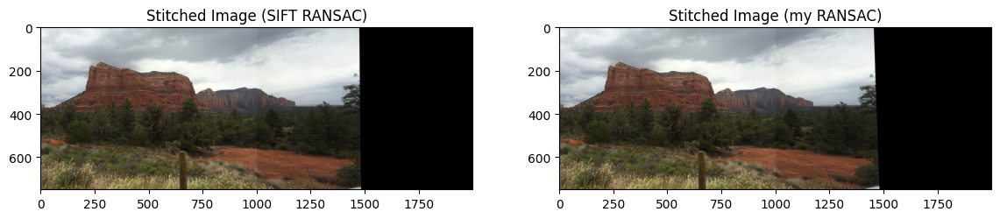

In [105]:
plt.figure(figsize=(14, 6))

# 원본 이미지 출력
plt.subplot(1, 2, 1)
plt.imshow(stitched_ransac_sedona)
plt.title('Stitched Image (SIFT RANSAC)')


# 원본 이미지 출력
plt.subplot(1, 2, 2)
plt.imshow(my_stitched_ransac_sedona)
plt.title('Stitched Image (my RANSAC)')
plt.show()

- 결과 :
SIFT RANSAC와 my RANSAC의 결과가 매우 유사합니다.
직접 구현한 함수 find_homography_ransac가 올바르게 구현된 것으로 판단됩니다.

- 종합 결론 : 모든 이미지가 SIFT RANSAC의 결과와 거의 동일하게 나타났습니다. 직접 구현한 함수 find_homography_ransac가 올바르게 구현된 것으로 판단됩니다.